## Notebookの下準備

### Jupyter用ライブラリの読み込み・設定

In [2]:
# black formatterの設定
import jupyter_black

jupyter_black.load()

### 実行設定

In [3]:
DATASET_TYPE = "SMALL"  # RECODE or SMALL

## ライブラリのimport

In [4]:
import itertools
import pickle
import shelve
import numpy as np
import pandas as pd
import scipy.linalg as spl
import scipy.stats
import scipy.stats as sps
import sklearn
import sklearn.mixture
import matplotlib
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap.umap_ as umap
import time

# import os
import glob
import csv
import screcode
from scipy.stats import multivariate_normal
import seaborn as sns

sns.set_style("whitegrid")
from natsort import natsorted
import ot

# import ot.plot
import matplotlib.animation as animation
from PIL import Image
from matplotlib.animation import PillowWriter
import itertools
import networkx as nx
import plotly.express as px
import plotly.graph_objects as go
from sklearn.utils import check_random_state
from IPython.display import HTML
from IPython.display import Image
import warnings

warnings.filterwarnings("ignore")
from scipy import interpolate
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from sklearn import linear_model
import pydotplus
from sklearn.neighbors import kneighbors_graph
from scipy import sparse

import os

## 定数定義

### Path

In [29]:
# pathの最後がディレクトリの場合はスラッシュをつける

# --- 加工前のデータセットのpath ---
DATASET_INPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/input/")
DATASET_PATH_BEFORE_PCA = os.path.join(
    DATASET_INPUT_ROOT_PATH,
    "usedataSMALL/" if DATASET_TYPE == "SMALL" else "usedataRECODE/",
)

# TODO: ディレクトリの作成タイミング考える
# --- 保存先path ---
# 加工後データセット
DATASET_OUTPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/output/")
DATASET_PATH_WITHOUT_MT = os.path.join(
    DATASET_OUTPUT_ROOT_PATH,
    "usedataSMALL_withoutMT/"
    if DATASET_TYPE == "SMALL"
    else "usedataRECODE_withoutMT/",
)
DATASET_PATH_AFTER_PCA = os.path.join(DATASET_PATH_WITHOUT_MT, "logPCA/")
DATASET_PATH_AFTER_UMAP = os.path.join(DATASET_PATH_WITHOUT_MT, "logUMAP/")
# データセット以外のoutputのpath
OUTPUT_PATH_OTHER_THAN_DATASET = os.path.join(os.getcwd(), "output/")
GMM_PATH = os.path.join(OUTPUT_PATH_OTHER_THAN_DATASET, "gmm/")
GMM_MODEL_PATH = os.path.join(GMM_PATH, "models/")
GMM_LABEL_PATH = os.path.join(GMM_PATH, "labels/")
UMAP_MODEL_PATH = os.path.join(OUTPUT_PATH_OTHER_THAN_DATASET, "umap/")
FIGURE_PATH_PCA = os.path.join(OUTPUT_PATH_OTHER_THAN_DATASET, "figure_PCA/")
FIGURE_PATH_UMAP = os.path.join(OUTPUT_PATH_OTHER_THAN_DATASET, "figure_UMAP/")

### ファイル名

In [7]:
DATASET_NAMES_BY_DAY = ["D0", "D05", "D1", "D15", "D2"]
DAY_LIST_WITH_DECIMAL_POINT = ["0", "0.5", "1", "1.5", "2"]
FIGURE_TITLES_BY_DAY = [f"Day {day}" for day in DAY_LIST_WITH_DECIMAL_POINT]
FIGURE_NAMES_BY_DAY = [f"Day{day}" for day in DAY_LIST_WITH_DECIMAL_POINT]

### ハイパーパラメータ

In [8]:
# 共通
RANDOM_STATE = 2022
# PCA
PCA_N_COMPONENTS = 30  # 150
# GMM
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]  # 各dayのクラスタ数
# UMAP
UMAP_N_NEIGHBORS = 1000
UMAP_N_COMPONENTS = 2

## 関数定義

### utils

In [9]:
def print_all_files(all_files):
    for file in all_files:
        print(file)


def densite_theorique2d(mu, Sigma, alpha, x):
    K = mu.shape[0]
    alpha = alpha.reshape(1, K)
    y = 0
    for j in range(K):
        y += alpha[0, j] * sps.multivariate_normal.pdf(
            x, mean=mu[j, :], cov=Sigma[j, :, :]
        )
    return y


def GaussianW(m0, m1, Sigma0, Sigma1):
    Sigma00 = spl.sqrtm(Sigma0)
    Sigma010 = spl.sqrtm(Sigma00 @ Sigma1 @ Sigma00)
    d = np.linalg.norm(m0 - m1) ** 2 + np.trace(Sigma0 + Sigma1 - 2 * Sigma010)
    return d


def EGW(pi0, pi1, mu0, mu1, S0, S1):
    K0 = mu0.shape[0]
    K1 = mu1.shape[0]
    d = mu0.shape[1]
    S0 = S0.reshape(K0, d, d)
    S1 = S1.reshape(K1, d, d)
    M = np.zeros((K0, K1))
    for k in range(K0):
        for l in range(K1):
            M[k, l] = GaussianW(mu0[k, :], mu1[l, :], S0[k, :, :], S1[l, :, :])
    wstar = ot.sinkhorn(
        pi0,
        pi1,
        M / M.max(),
        0.01,
        method="sinkhorn_epsilon_scaling",
        numItermax=10000000000,
        tau=1e8,
        stopThr=1e-9,
    )
    return wstar

### GMM

### PCA

In [10]:
def preprocess_concated_data(X, n_components):
    """Apply PCA to X.

    Preprocess in the following order.
    deleting MTgenes -> UMInormalized -> Log2scaling -> PCA

    X is assumed to be the two-dimensional data
    concatenated two-dimensional data for each day.

    Parameters
    ----------
    X: array-like of shape (n_samples, n_features)
        Training data to preprocess.
    n_components: int
        The estimated number of components in PCA.

    Returns
    ----------
    X : array-like of shape (n_samples, n_components)
        Preprodessed and dimensionality reduced X.

    Attributes
    ----------
    n_samples: int
        Number of samples in the tranining data.
    n_features: int
        Number of samples in the training data.
    """

    # TODO:
    # これは各ユーザーが前もってやるようにする
    def delete_MTgenes(X):
        X.drop(X.columns[X.columns.str.startswith("MT-")], axis=1, inplace=True)
        return X

    def print_datainfo(X):
        genes = X.columns
        cells = X.index
        print(len(genes), "genes,", len(cells), "cells")
        nreads = X.values.sum(axis=1)
        ngenes = (X.values > 0.0).astype(int).sum(axis=1)
        print(
            "Assigned reads: max=",
            np.max(nreads),
            "min=",
            np.min(nreads),
            "average={:.2f}".format(np.average(nreads)),
        )
        print(
            "Detected genes: max=",
            np.max(ngenes),
            "min=",
            np.min(ngenes),
            "average={:.2f}".format(np.average(ngenes)),
        )

    def UMInormalize(X, UMI_norm=100000):
        X = X.div(X.sum(axis=1), axis=0) * UMI_norm
        return X

    def log2normalize(X):
        X = X.where(X > 0, 0)
        X = pd.DataFrame(np.log1p(X.values), index=X.index, columns=X.columns)
        return X

    X = delete_MTgenes(X)
    print_datainfo(X)
    X = UMInormalize(X)
    X = log2normalize(X)
    pca = PCA(n_components=n_components)
    X = pd.DataFrame(
        pca.fit_transform(X.values),
        index=X.index,
        columns=["PC{}".format(i + 1) for i in range(n_components)],
    )
    print(
        f"sum of explained_variance_ratio = {sum(pca.explained_variance_ratio_ * 100)}"
    )
    return X

In [11]:
def preprocess_not_concated_data(X, n_components, recode=False):
    """Preprocess to X.

    Preprocess in the following order.
    deleting MTgenes -> UMInormalized -> Log2scaling -> PCA

    X is assumed to be an array whose elements are two-dimensional data
    for each day.

    Parameters
    ----------
    X: array-like of shape (n_days, n_samples, n_features)
        Training data to preprocess.
    n_components: int
        The estimated number of components in PCA.
    recode: bool, default=False
        If True, apply recode before deleting MTgenes.

    Returns
    ----------
    X: array-like of shape (n_days, n_sample, n_components)
        Preprodessed and dimensionality reduced X.

    Attributes
    ----------
    n_days: int
        Number of days in the training data.
    n_samples: int
        Number of samples in the tranining data.
    n_features: int
        Number of samples in the training data.
    """

    def count_cells(X):
        cell_count_for_each_day = [len(df.index) for df in X]
        return cell_count_for_each_day

    def apply_RECODE(X):
        for i in range(len(X)):
            X[i] = pd.DataFrame(
                screcode.RECODE().fit_transform(X[i].values),
                index=X[i].index,
                columns=X[i].columns,
            )
        return X

    def concat_each_days_data(X):
        return pd.concat(X, axis=0, join="inner")

    def split_concated_data_by_day(X_concated, cell_count_for_each_day):
        cell_count_accumulated = list(itertools.accumulate(cell_count_for_each_day))
        X_splited = [
            X_concated[
                cell_count_accumulated[i - 1]
                if i > 0
                else 0 : cell_count_accumulated[i]
            ]
            for i in range(len(cell_count_accumulated))
        ]
        return X_splited

    cell_count_for_each_day = count_cells(X)
    if recode:
        X = apply_RECODE(X)
    X_concated = preprocess_concated_data(concat_each_days_data(X), n_components)
    X = split_concated_data_by_day(X_concated, cell_count_for_each_day)

    return X

In [12]:
def apply_GMM_to_each_day(X, cluster_numbers, random_state=None):
    """Apply GMM to X.
    GMM stands for Gaussian Mixture model.
    See: https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html

    X is assumed to be an array whose elements are two-dimensional data
    for each day.

    Parameters
    ---------
    X: array-like of shape (n_days, n_samples, n_features)
        The data to apply GMM.
    cluster_numbers: array-like of shape (n_days, )
        List of the number of misture components(n_components) of GMM
        for each day.
    random_state: int, RandomState instance or None, default=None
        Determing seed that initializes random number generator.

    Returns
    ----------
    gmm_list: array-like of shape (n_days, )
        List of scikit-learn's Gaussian Mixture model for eacy day.

    Attributes
    ---------
    n_days:
        Number of days in the training data.
    n_samples:
        Number of samples in the training data.
    n_features:
        Number of features in the training data.
        Usually matches PCA's n_components.
    """

    gmm_list = []

    for i in range(len(X)):
        n_components = cluster_numbers[i]

        gmm = sklearn.mixture.GaussianMixture(
            n_components,
            covariance_type="full",
            max_iter=2000,
            n_init=10,
            random_state=random_state,
        )
        gmm.fit(X[i].values)

        gmm_list.append(gmm)

    return gmm_list

### UMAP

In [13]:
def apply_UMAP_to_concated_data(
    X, n_components, n_neighbors, random_state, min_dist=0.8
):
    """Apply UMAP to X.
    See: https://umap-learn.readthedocs.io/en/latest/index.html

    X is assumed to be the two-dimensional data
    concatenated two-dimensional data for each day.

    Parameters
    ----------
    X: array-like of shape (n_samples, n_features)
        The data to apply UMAP.
    n_components: int
        The estimated number of components in UMAP.
    n_neighbors: float
        The size of local neighborhood (in terms of number of neighboring
        sample points) used for manifold approximation.
        See: https://umap-learn.readthedocs.io/en/latest/parameters.html#n-neighbors
    random_state: int, RandomState instance or None, default=None
        Determing seed that initializes random number generator.
    min_dist: float, default=0.8
        The effective minimum distance between embedded points.
        See: https://umap-learn.readthedocs.io/en/latest/parameters.html#min-dist

    Returns
    ----------
    X : array-like of shape (n_samples, n_components)
        Preprodessed and dimensionality reduced X.

    Attributes
    ----------
    n_samples: int
        Number of samples in the tranining data.
    n_features: int
        Number of samples in the training data.
        Usually matches PCA's n_components.
    """

    umap_model = umap.UMAP(
        n_components=UMAP_N_COMPONENTS,
        n_neighbors=UMAP_N_NEIGHBORS,
        random_state=RANDOM_STATE,
        min_dist=0.8,
    )
    umap_coords = umap_model.fit_transform(X.values)
    X = pd.DataFrame(
        umap_model.fit_transform(X.values), index=X.index, columns=["UMAP1", "UMAP2"]
    )
    return X

In [14]:
def apply_UMAP_to_not_concated_data(
    X, n_components, n_neighbors, random_state, min_dist=0.8
):
    """Apply UMAP to X.
    See: https://umap-learn.readthedocs.io/en/latest/index.html

    X is assumed to be an array whose elements are two-dimensional data
    for each day.

    Parameters
    ----------
    X: array-like of shape (n_days, n_samples, n_features)
        The data to apply UMAP.
    n_components: int
        The estimated number of components in UMAP.
    n_neighbors: float
        The size of local neighborhood (in terms of number of neighboring
        sample points) used for manifold approximation.
        See: https://umap-learn.readthedocs.io/en/latest/parameters.html#n-neighbors
    random_state: int, RandomState instance or None, default=None
        Determing seed that initializes random number generator.
    min_dist: float, default=0.8
        The effective minimum distance between embedded points.
        See: https://umap-learn.readthedocs.io/en/latest/parameters.html#min-dist

    Returns
    ----------
    X : array-like of shape (n_samples, n_components)
        Preprodessed and dimensionality reduced X.

    Attributes
    ----------
    n_samples: int
        Number of samples in the tranining data.
    n_features: int
        Number of samples in the training data.
        Usually matches PCA's n_components.
    """

    def count_cells(X):
        cell_count_for_each_day = [len(df.index) for df in X]
        return cell_count_for_each_day

    def concat_each_days_data(X):
        return pd.concat(X, axis=0, join="inner")

    def split_concated_data_by_day(X_concated, cell_count_for_each_day):
        cell_count_accumulated = list(itertools.accumulate(cell_count_for_each_day))
        X_splited = [
            X_concated[
                cell_count_accumulated[i - 1]
                if i > 0
                else 0 : cell_count_accumulated[i]
            ]
            for i in range(len(cell_count_accumulated))
        ]
        return X_splited

    cell_count_for_each_day = count_cells(X)
    X_concated = apply_UMAP_to_concated_data(
        concat_each_days_data(X), n_components, n_neighbors, random_state, min_dist
    )
    X = split_concated_data_by_day(X_concated, cell_count_for_each_day)
    return X

In [15]:
# TODO:
# Noneの場合の処理
def plot_GMM_predictions(
    X,
    gmm_list,
    gmm_labels,
    x_range,
    y_range,
    figure_labels,
    figure_titles_without_gmm=None,
    figure_titles_with_gmm=None,
    plot_gmm_means=False,
    save=False,
    save_file_paths=None,
):
    """Show side-by-side display of X without and with GMM labels.

    Parameters
    ----------
    X: array-like of shape (n_days, n_samples, n_features)
        The data to predict GMM labels in each samples.
    gmm_list: ndarray of shape (n_days, )
        List of GMM models for each day.
    x_range: tuple of shape (2, )
        A tuple of x-axis limits.
    y_range: tuple of shape (2, )
        A tuple of y-axis limits.
    figure_labels: ndarray of shape (2, )
        Labels for x- and y-axis.
    figure_titles_without_gmm: ndarray of shape (n_days, ), default=None
        List of titles of figures without GMM labels.
    figure_titles_with_gmm: ndarray of shape (n_days, ), default=None
        List of titles of figures with GMM labels.
    plot_gmm_means: bool, default=False
        if true, plot means of each GMM distribution.
    save: bool, default=False
        If true, save each day's figure in a image file.
    save_file_paths: ndarray of shape (n_days, ), default=None
        Only works if save=True.
        Specify where to save each image.

    Attributes
    ----------
    n_days:
        Number of days in the training data.
    n_samples:
        Number of samples in the training data.
    n_features:
        Number of features in the training data.
        Usually matches PCA's n_components.
    """

    def plot_data(
        X, x_range, y_range, figure_labels, gmm_labels=None, n_components=None
    ):
        if gmm_labels is None:
            plt.scatter(X.values[:, 0], X.values[:, 1], s=0.5, alpha=0.8)
        else:
            plt.scatter(
                X.values[:, 0],
                X.values[:, 1],
                c=gmm_labels,
                cmap=plt.cm.get_cmap("cubehelix", n_components),
                edgecolor="gray",
            )
        plt.xlabel(figure_labels[0])
        plt.ylabel(figure_labels[1])
        plt.xlim(x_range)
        plt.ylim(y_range)
        if gmm_labels is not None:
            plt.colorbar(ticks=range(n_components), label="cluster")
            plt.clim(-0.5, n_components - 0.5)

    if figure_titles_without_gmm is None:
        figure_titles_without_gmm = [f"Figure {i} - wighout GMM" for i in range(len(X))]
    if figure_titles_with_gmm is None:
        figure_titles_with_gmm = [f"Figure {i} - with GMM" for i in range(len(X))]
    if save is not None and save_file_paths is None:
        save_file_paths = [f"./GMM_preds_figure_{i}.png" for i in range(len(X))]

    for i in range(len(X)):
        plt.figure(figsize=(20, 8))
        plt.subplot(1, 2, 1)
        plot_data(X[i], x_range, y_range, figure_labels)
        plt.title(figure_titles_without_gmm[i], fontsize=20)

        plt.subplot(1, 2, 2)
        gmm = gmm_list[i]
        n_components = len(gmm.weights_)

        if plot_gmm_means:
            for k in range(n_components):
                plt.plot(gmm.means_[k][0], gmm.means_[k][1], "ro")

        plot_data(
            X[i],
            x_range,
            y_range,
            figure_labels,
            gmm_labels=gmm_labels[i],
            n_components=n_components,
        )
        plt.title(figure_titles_with_gmm[i], fontsize=20)
        if save:
            plt.savefig(save_file_paths[i], dpi=600)
        plt.show()

### 動画（分化の様子？）

In [26]:
def interpolation_contour(t, x_range, y_range):
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )

    x = np.linspace(x_range[0], x_range[1], 1000)
    y = np.linspace(y_range[0], y_range[1], 1000)
    X, Y = np.meshgrid(x, y)
    XX = np.array([X.ravel(), Y.ravel()]).T
    Z = densite_theorique2d(mut[:, 0:2], St[:, 0:2, 0:2], pit, XX)
    Z = Z.reshape(X.shape)
    maxZ = np.max(Z)
    minZ = np.min(Z)
    img = plt.contour(X, Y, Z, np.linspace(minZ - 1e-9, maxZ, 20), cmap="rainbow")
    return img.collections

### cell state

In [47]:
def list_cluster_all(all_files, file_name, cluster_numbers):
    cluster_all = []
    cluster_temp = []
    all_days = len(all_files)
    for day in range(all_days):
        n_components1 = cluster_numbers[day]
        t = range(n_components1)
        for n2 in t:
            cluster_temp.append(f"d{file_name[day]}-c{n2}")
        cluster_all.append(cluster_temp)
        cluster_temp = []
    return cluster_all


def df_makegraph(all_files, cluster_all, wstar_all, Thr=0.05):
    all_days = len(all_files)
    product = []
    result = []
    for day in range(all_days - 1):
        test2 = {"source": cluster_all[day], "target": cluster_all[day + 1]}
        product = product + [
            x for x in itertools.product(cluster_all[day], cluster_all[day + 1])
        ]
    result = result + [dict(zip(test2.keys(), r)) for r in product]
    df_graph = pd.DataFrame(result)

    temp = itertools.chain.from_iterable(list(itertools.chain.from_iterable(wstar_all)))
    df_graph["edge_weights"] = list(temp)

    df_graph = df_graph[df_graph["edge_weights"] > Thr]
    return df_graph


def df_fold_change(df_genes, cluster1, cluster2):
    gene_exp1 = df_genes.T[cluster1]
    gene_exp2 = df_genes.T[cluster2]
    FC = gene_exp2 - gene_exp1
    df_FC = pd.DataFrame(index=FC.index)
    df_FC["FC"] = FC.values
    df_FC_sort = df_FC.sort_values(by=["FC"], ascending=False)
    return df_FC_sort


def df_up_regulated_genes(df_genes, df_graph, num=10):
    source_name = df_graph["source"]
    target_name = df_graph["target"]
    sum_name = source_name + target_name
    df_upgenes = pd.DataFrame([])
    for i in range(len(sum_name)):
        s1 = source_name.values[i]
        s2 = target_name.values[i]
        df_FC = df_fold_change(df_genes, s1, s2)
        upgenes = df_FC.apply(get_genes_nlargest, num=num)
        df_upgenes = df_upgenes.append(upgenes["FC"], ignore_index=True)
    df_upgenes = pd.DataFrame(
        df_upgenes.values, index=sum_name, columns=df_upgenes.columns
    )
    df_upgenes.columns += 1
    return df_upgenes


def df_down_regulated_genes(df_genes, df_graph, num=10):
    source_name = df_graph["source"]
    target_name = df_graph["target"]
    sum_name = source_name + target_name
    df_downgenes = pd.DataFrame([])
    for i in range(len(sum_name)):
        s1 = source_name.values[i]
        s2 = target_name.values[i]
        df_FC = df_fold_change(df_genes, s1, s2)
        downgenes = df_FC.apply(get_genes_nsmallest, num=num)
        df_downgenes = df_downgenes.append(downgenes["FC"], ignore_index=True)
    df_downgenes = pd.DataFrame(
        df_downgenes.values, index=sum_name, columns=df_downgenes.columns
    )
    df_downgenes.columns += 1
    return df_downgenes


def df_makenodeweights_and_pos(node_weights, cluster_all, xpos, ypos, node_day):
    df_nodeweights_and_pos = pd.DataFrame(
        node_weights, index=cluster_all, columns=["node_weights"]
    )
    df_nodeweights_and_pos["xpos"] = xpos
    df_nodeweights_and_pos["ypos"] = ypos
    df_nodeweights_and_pos["node_days"] = node_day
    return df_nodeweights_and_pos


def cell_state_graph(
    G,
    pos,
    df_node_up_gene_sets,
    df_node_down_gene_sets,
    df_edge_up_gene_sets,
    df_edge_down_gene_sets,
):
    tail_list = []
    head_list = []
    trace_recode = []
    text_node_up_gene_sets = df_node_up_gene_sets.values
    text_node_down_gene_sets = df_node_down_gene_sets.values

    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        tail_list.append(pos[edge[0]])
        head_list.append(pos[edge[1]])
        weight = G.edges[edge]["edge_weights"] * 25

        edge_trace = go.Scatter(
            x=tuple([x0, x1, None]),
            y=tuple([y0, y1, None]),
            mode="lines",
            line={"width": weight},
            line_color="slateblue",
            line_shape="spline",
            opacity=0.4,
        )

        trace_recode.append(edge_trace)

    middle_hover_trace = go.Scatter(
        x=[],
        y=[],
        hovertext=[],
        mode="markers",
        textposition="top center",
        hoverinfo="text",
        marker={"size": 20, "color": "slateblue"},
        opacity=0,
    )

    for edge in G.edges:
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        from_to = str(edge[0]) + str(edge[1])
        hovertext1 = df_edge_up_gene_sets.T[from_to].values
        hovertext2 = df_edge_down_gene_sets.T[from_to].values
        hovertext = "up_gene: " + hovertext1 + " " + "down_gene: " + hovertext2 + "<br>"
        middle_hover_trace["x"] += tuple([(x0 + x1) / 2])
        middle_hover_trace["y"] += tuple([(y0 + y1) / 2])
        middle_hover_trace["hovertext"] += tuple([hovertext])
        trace_recode.append(middle_hover_trace)

    head_trace = [
        go.Scatter(x=[head[0]], y=[head[1]], mode="lines+markers") for head in head_list
    ]

    tail_trace = [
        go.Scatter(x=[tail[0]], y=[tail[1]], mode="markers") for tail in tail_list
    ]

    arrows = [
        go.layout.Annotation(
            dict(
                x=head[0],
                y=head[1],
                showarrow=True,
                xref="x",
                yref="y",
                arrowcolor="slateblue",
                arrowsize=2,
                arrowwidth=2,
                ax=tail[0],
                ay=tail[1],
                axref="x",
                ayref="y",
                arrowhead=1,
            )
        )
        for head, tail in zip(head_list, tail_list)
    ]

    arrow_trace = head_trace + tail_trace

    node_x = []
    node_y = []
    node_hover_trace = go.Scatter(
        x=[],
        y=[],
        hovertext=[],
        mode="markers",
        textposition="top center",
        hoverinfo="text",
        marker={"size": 20, "color": [w["day"] for w in G.nodes.values()]},
        opacity=0,
    )

    for node in G.nodes():
        x, y = pos[node]
        node_x.append(x)
        node_y.append(y)
        hovertext1 = df_node_up_gene_sets.T[node].values
        hovertext2 = df_node_down_gene_sets.T[node].values
        hovertext = (
            "largest_gene: "
            + hovertext1
            + " "
            + "smallest_gene: "
            + hovertext2
            + "<br>"
        )
        node_hover_trace["x"] += tuple([x])
        node_hover_trace["y"] += tuple([y])
        node_hover_trace["hovertext"] += tuple([hovertext])
        trace_recode.append(node_hover_trace)

    node_trace = go.Scatter(
        x=node_x,
        y=node_y,
        text=list(G.nodes()),
        textposition="top center",
        mode="markers+text",
        hoverinfo="text",
        marker=dict(line_width=2),
    )

    node_trace.marker.color = [w["day"] for w in G.nodes.values()]
    node_trace.marker.size = [w["weight"] * 140 for w in G.nodes.values()]
    trace_recode.append(node_trace)

    fig = go.Figure(
        data=trace_recode, layout=go.Layout(showlegend=False, hovermode="closest")
    )

    fig.update_layout(annotations=arrows)

    fig.update_layout(width=1000, height=800, title="Cell state graph")
    fig.show()


def plot_fold_change(df_genes, cluster1, cluster2, threshold=1.0):
    df_genes_FC = pd.DataFrame(index=df_genes.T.index)
    df_genes_FC[cluster1] = df_genes.T[cluster1]
    df_genes_FC[cluster2] = df_genes.T[cluster2]

    fig = go.Figure()
    gene_exp1 = df_genes_FC[cluster1]
    gene_exp2 = df_genes_FC[cluster2]
    absFC = (gene_exp2 - gene_exp1).abs()
    df_genes_FC2 = df_genes_FC.loc[
        df_genes_FC.index.isin(absFC[absFC.values > threshold].index), :
    ]
    text1 = df_genes.T.index
    text2 = df_genes_FC2.index

    fig.add_trace(
        go.Scatter(
            x=df_genes.T[cluster1],
            y=df_genes.T[cluster2],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"|FC| < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_genes_FC2[cluster1],
            y=df_genes_FC2[cluster2],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"|FC| > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": cluster1},
        yaxis={"title": cluster2},
        width=1000,
        height=800,
        showlegend=True,
        title=f"Fold Change (threshold = {threshold})",
    )
    fig.show()

### pathway

In [48]:
def plot_pathway_mean_var(df_pathway_genes, threshold=1.0):
    mean = df_pathway_genes.mean(axis=0)
    var = df_pathway_genes.var(axis=0)
    df_pathway_mean_var = pd.DataFrame(
        mean, index=df_pathway_genes.columns, columns=["mean"]
    )
    df_pathway_mean_var["var"] = var

    fig = go.Figure()
    df_pathway_mean_var2 = df_pathway_mean_var.loc[
        df_pathway_mean_var.index.isin(
            df_pathway_mean_var[df_pathway_mean_var["var"].values > threshold].index
        ),
        :,
    ]
    text1 = df_pathway_mean_var.index
    text2 = df_pathway_mean_var2.index

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_var["mean"],
            y=df_pathway_mean_var["var"],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"var < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_var2["mean"],
            y=df_pathway_mean_var2["var"],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"var > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": "mean"},
        yaxis={"title": "var"},
        width=1000,
        height=800,
        showlegend=True,
        title=f"pathway_mean_var (threshold = {threshold})",
    )
    fig.show()


def plot_pathway_gene_expressions(df_pathway_genes, selected_genes):
    df_pathway_selected_genes = df_pathway_genes.loc[
        :, df_pathway_genes.columns.isin(selected_genes)
    ]
    fig = go.Figure()
    for gene_name in df_pathway_selected_genes.columns:
        fig.add_trace(
            go.Scatter(
                x=df_pathway_selected_genes.index,
                y=df_pathway_selected_genes[gene_name].values,
                mode="lines+markers",
                name=gene_name,
                line_shape="spline",
            )
        )

    fig.update_layout(
        xaxis={"title": "day"},
        yaxis={"title": "log(gene_exp+1)"},
        width=1200,
        height=800,
        showlegend=True,
        title="pathway_gene_expressions",
    )
    fig.show()

### 単一遺伝子の特徴量のプロット

### interpolation

In [87]:
def df_make_interpolation_data(gmm1, gmm2, df1, df2, n_samples, t):
    d = PCA_N_COMPONENTS # TODO: このあたりのグローバル変数への参照をなくす
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = EGW(
        np.ravel(pi0),
        np.ravel(pi1),
        mu0.reshape(K0, d),
        mu1.reshape(K1, d),
        S0.reshape(K0, d, d),
        S1.reshape(K1, d, d),
    )
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )
    K = mut.shape[0]
    pit = pit.reshape(1, K)
    means = mut
    covariances = St
    weights = pit[0, :]
    n_features = mut.shape[0]
    rng = check_random_state(0)
    n_samples_comp = rng.multinomial(n_samples, weights)
    X_interpolation = np.vstack(
        [
            rng.multivariate_normal(mean, covariance, int(sample))
            for (mean, covariance, sample) in zip(means, covariances, n_samples_comp)
        ]
    )
    df_interpolation = pd.DataFrame(X_interpolation, columns=df1.columns)
    return df_interpolation


def interpolation_data(n_samples, t):
    pit = wstar.reshape(K0 * K1, 1).T
    mut = np.zeros((K0 * K1, d))
    St = np.zeros((K0 * K1, d, d))
    for k in range(K0):
        for l in range(K1):
            mut[k * K1 + l, :] = (1 - t) * mu0[k, :] + t * mu1[l, :]
            Sigma1demi = spl.sqrtm(S1[l, :, :])
            C = (
                Sigma1demi
                @ spl.inv(spl.sqrtm(Sigma1demi @ S0[k, :, :] @ Sigma1demi))
                @ Sigma1demi
            )
            St[k * K1 + l, :, :] = (
                ((1 - t) * np.eye(d) + t * C)
                @ S0[k, :, :]
                @ ((1 - t) * np.eye(d) + t * C)
            )
    K = mut.shape[0]
    pit = pit.reshape(1, K)
    means = mut
    covariances = St
    weights = pit[0, :]
    n_features = mut.shape[0]
    rng = check_random_state(0)
    n_samples_comp = rng.multinomial(n_samples, weights)
    X_interpolation = np.vstack(
        [
            rng.multivariate_normal(mean, covariance, int(sample))
            for (mean, covariance, sample) in zip(means, covariances, n_samples_comp)
        ]
    )
    return X_interpolation

### cell velocity

In [99]:
def GaussianMap(m0, m1, Sigma0, Sigma1, x):
    d = Sigma0.shape[0]
    m0 = m0.reshape(1, d)
    m1 = m1.reshape(1, d)
    Sigma0 = Sigma0.reshape(d, d)
    Sigma1 = Sigma1.reshape(d, d)
    Sigma = np.linalg.pinv(Sigma0) @ spl.sqrtm(Sigma0 @ Sigma1)
    Tx = m1 + (x - m0) @ Sigma
    return Tx


def compute_cell_velocity(gmm1, gmm2, df1):
    d = PCA_N_COMPONENTS  # Todo: グローバル変数への参照無くす
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    m0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    m1 = gmm2.means_
    S1 = gmm2.covariances_
    n = df1.values.shape[0]
    T = np.zeros((K0, K1, PCA_N_COMPONENTS, n))
    barycentric_projection_map = np.zeros((PCA_N_COMPONENTS, n))
    Nj = np.zeros((n, K0))

    for k in range(K0):
        for l in range(K1):
            T[k, l, :, :] = GaussianMap(
                m0[k, :], m1[l, :], S0[k, :, :], S1[l, :, :], df1.values
            ).T
    for j in range(K0):
        logprob = gmm1.score_samples(df1.values)
        pdf = np.exp(logprob)
        Nj[:, j] = np.exp(
            np.log(
                sps.multivariate_normal.pdf(df1.values, mean=m0[j, :], cov=S0[j, :, :])
            )
            - logprob
        )
    for k in range(K0):
        for l in range(K1):
            barycentric_projection_map += wstar[k, l] * Nj[:, k].T * T[k, l, :, :]
    w = barycentric_projection_map.T
    velo = w - df1.values
    return velo


def cell_velocity_plot(
    x_coordinate,
    y_coordinate,
    x_velocity,
    y_velocity,
    speed,
    cmap="rainbow",
    mode="PCA",
):
    if mode == "PCA":
        plt.figure(figsize=(10, 8))
        plt.quiver(
            x_coordinate,
            y_coordinate,
            x_velocity / speed,
            y_velocity / speed,
            speed,
            cmap=cmap,
            scale=1,
            scale_units="xy",
        )
        plt.xlim(np.min(x_coordinate) - 5, np.max(x_coordinate) + 5)
        plt.ylim(np.min(y_coordinate) - 5, np.max(y_coordinate) + 5)
        plt.xlabel("PC1")
        plt.ylabel("PC2")
        plt.colorbar()
        # plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/cell_velocity.png",dpi=300)
        plt.show()

    if mode == "UMAP":
        plt.figure(figsize=(10, 8))
        plt.quiver(
            x_coordinate,
            y_coordinate,
            x_velocity / speed,
            y_velocity / speed,
            speed,
            cmap="rainbow",
            scale=2.5,
            scale_units="xy",
        )
        plt.xlim(np.min(x_coordinate) - 1, np.max(x_coordinate) + 1)
        plt.ylim(np.min(y_coordinate) - 1, np.max(y_coordinate) + 1)
        plt.xlabel("UMAP1")
        plt.ylabel("UMAP2")
        plt.colorbar()
        # plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/cell_velocity_UMAP.png",dpi=300)
        plt.show()


def make_GRN(df, threshold=0.1):
    graph = pydotplus.Dot(graph_type="digraph")
    for c in df.columns:
        node = pydotplus.Node(f'"{c}"', label=c)
        graph.add_node(node)
    for i in df.index:
        for c in df.columns:
            val = df.loc[i, c]
            if abs(val) > threshold:
                edge = pydotplus.Edge(
                    graph.get_node(f'"{i}"')[0], graph.get_node(f'"{c}"')[0]
                )
                edge.set_label("{:.2f}".format(df.loc[i, c]))
                edge.set_penwidth(4 * (abs(val) - threshold) / (1 - threshold))
                h, s, v = 0.0 if val > 0 else 2 / 3, abs(val) + 1, 1.0
                edge.set_color(" ".join([str(i) for i in (h, s, v)]))
                graph.add_edge(edge)
    return graph

### 使われていない関数

In [51]:
def df_screcode(df):
    X_recode = screcode.RECODE().fit_transform(df.values)
    df_screcode = pd.DataFrame(X_recode, index=df.index, columns=df.columns)
    return df_screcode


def df_concat_all_files_screcode(all_files):
    df = pd.read_csv(all_files[0], index_col=0)
    X_recode = screcode.RECODE().fit_transform(df.values)
    df_screcode = pd.DataFrame(X_recode, index=df.index, columns=df.columns)
    for i in range(1, len(all_files)):
        df1 = pd.read_csv(all_files[i], index_col=0)
        X1_screcode = screcode.RECODE().fit_transform(df1.values)
        df1_screcode = pd.DataFrame(X1_screcode, index=df1.index, columns=df1.columns)
        df_screcode = pd.concat([df_screcode, df1_screcode], axis=0, join="inner")
    return df_screcode


def df_PCA(df, n_components):
    pca = PCA(n_components=n_components)
    pca.fit(df.values)
    Xpca = pca.transform(df.values)
    df_pca = pd.DataFrame(
        Xpca,
        index=df.index,
        columns=["PC{}".format(x + 1) for x in range(n_components)],
    )
    print("sum of explained_variance_ratio =", sum(pca.explained_variance_ratio_ * 100))
    return df_pca


def plot_pathway_mean_cv(df_pathway_genes, threshold=1.0):
    mean = df_pathway_genes.mean(axis=0)
    std = df_pathway_genes.std(axis=0)
    cv = std / mean
    df_pathway_mean_cv = pd.DataFrame(
        mean, index=df_pathway_genes.columns, columns=["mean"]
    )
    df_pathway_mean_cv["cv"] = cv

    fig = go.Figure()
    df_pathway_mean_cv2 = df_pathway_mean_cv.loc[
        df_pathway_mean_cv.index.isin(
            df_pathway_mean_cv[df_pathway_mean_cv["cv"].values > threshold].index
        ),
        :,
    ]
    text1 = df_pathway_mean_cv.index
    text2 = df_pathway_mean_cv.index

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_cv["mean"],
            y=df_pathway_mean_cv["cv"],
            mode="markers",
            marker={
                "symbol": "circle",
                "color": "blue",
                "opacity": 0.1,
            },
            text=text1,
            name=f"cv < {threshold}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_pathway_mean_cv2["mean"],
            y=df_pathway_mean_cv2["cv"],
            mode="markers+text",
            marker={
                "symbol": "circle",
                "color": "red",
                "opacity": 0.8,
            },
            text=text2,
            textposition="top center",
            name=f"cv > {threshold}",
        )
    )

    fig.update_layout(
        xaxis={"title": "mean"},
        yaxis={"title": "cv"},
        width=1000,
        height=800,
        showlegend=True,
        title=f"pathway_mean_cv (threshold = {threshold})",
    )
    fig.show()


# def sinkhorn(pi0,pi1,M,epsilon,itermax,threshold):
#    n_source = len(pi0)
#    n_target = len(pi1)
#    a = np.ones((n_source,))
#    b = np.ones((n_target,))

# Sinkhorn's algorithm
#    v = np.ones(n_target)
#    epsilon = epsilon
#    K = np.exp(-M/epsilon)
#    threshold = threshold
#    u = a / (np.dot(K,v))
#    itermax = itermax
#    for i in range(itermax):
#        if np.linalg.norm(u - a / np.dot(K,v),ord=1) + np.linalg.norm(v - b / (np.dot(np.transpose(K),u)),ord=1) < threshold:
# print('break at '+str(i))
#            break
#        u = a / (np.dot(K,v))
#        v = b / (np.dot(np.transpose(K),u))
#    P = np.dot(np.dot(np.diag(u),K),np.diag(v))
#    return P


def get_genes_nlargest(series, num=10):
    nlargest = series.nlargest(num)
    return nlargest.index


def get_genes_nsmallest(series, num=10):
    nsmallest = series.nsmallest(num)
    return nsmallest.index

## PCA

In [12]:
# データ確認 csvが時系列になっているか確認
all_files_before_PCA = sorted(glob.glob("{}*.csv".format(DATASET_PATH_BEFORE_PCA)))
print_all_files(all_files_before_PCA)

/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/input/usedataSMALL/D0.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/input/usedataSMALL/D05.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/input/usedataSMALL/D1.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/input/usedataSMALL/D15.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/input/usedataSMALL/D2.csv


In [23]:
X = [
    pd.read_csv(all_files_before_PCA[i], index_col=0)
    for i in range(len(all_files_before_PCA))
]

In [24]:
%%time
X = preprocess_not_concated_data(X, n_components=PCA_N_COMPONENTS)

2000 genes, 11790 cells
Assigned reads: max= 233682 min= 11879 average=53061.39
Detected genes: max= 1754 min= 988 average=1439.36
sum of explained_variance_ratio = 61.24579271988043
CPU times: user 24.4 s, sys: 36.8 s, total: 1min 1s
Wall time: 8.91 s


In [25]:
len(X), X[0].head()

(5,
                              PC1        PC2       PC3       PC4       PC5  \
 iM_AAACCCACAACAACAA-1 -15.682364  -6.815420  4.421904 -7.060302  2.681774   
 iM_AAACGAAAGCTAGTTC-1 -15.354941  -7.571727  3.271305 -1.468859  1.173126   
 iM_AAACGAATCCTGCCAT-1 -16.867010  -4.138908 -1.537045  1.832136  0.173499   
 iM_AAACGAATCGACGATT-1 -14.813776 -10.157570  2.796687 -6.300353 -0.233509   
 iM_AAACGAATCGCGGTAC-1 -17.043690  -6.463706  1.678962  3.952368 -3.207792   
 
                             PC6       PC7       PC8       PC9      PC10  ...  \
 iM_AAACCCACAACAACAA-1 -2.439774  1.604157  2.723660  0.191234  1.109947  ...   
 iM_AAACGAAAGCTAGTTC-1  0.165656  0.412830  2.184805  0.027812  0.808856  ...   
 iM_AAACGAATCCTGCCAT-1  4.021553 -1.421480  3.900686  0.466104 -4.630470  ...   
 iM_AAACGAATCGACGATT-1 -2.771433  0.245795 -3.161634  1.453046  2.043158  ...   
 iM_AAACGAATCGCGGTAC-1  9.004136 -4.312694  0.823802  0.639054 -5.157502  ...   
 
                            PC21      

In [26]:
os.makedirs(DATASET_PATH_AFTER_PCA, exist_ok=True)

for i in range(len(X)):
    X[i].to_csv(f"{DATASET_PATH_AFTER_PCA}{DATASET_NAMES_BY_DAY[i]}.csv")

## GMM

In [169]:
# TODO:
# 存在しない場合はエラーを出す
all_files_after_PCA = sorted(glob.glob("{}*.csv".format(DATASET_PATH_AFTER_PCA)))
print_all_files(all_files_after_PCA)

/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D0.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D05.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D1.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D15.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D2.csv


In [170]:
X = [
    pd.read_csv(all_files_after_PCA[i], index_col=0)
    for i in range(len(all_files_after_PCA))
]

In [171]:
len(X), X[0].head()

(5,
                              PC1        PC2       PC3       PC4       PC5  \
 iM_AAACCCACAACAACAA-1 -15.682364  -6.815420  4.421904 -7.060302  2.681774   
 iM_AAACGAAAGCTAGTTC-1 -15.354941  -7.571727  3.271305 -1.468859  1.173126   
 iM_AAACGAATCCTGCCAT-1 -16.867010  -4.138908 -1.537045  1.832136  0.173499   
 iM_AAACGAATCGACGATT-1 -14.813776 -10.157570  2.796687 -6.300353 -0.233509   
 iM_AAACGAATCGCGGTAC-1 -17.043690  -6.463706  1.678962  3.952368 -3.207792   
 
                             PC6       PC7       PC8       PC9      PC10  ...  \
 iM_AAACCCACAACAACAA-1 -2.439774  1.604157  2.723660  0.191234  1.109947  ...   
 iM_AAACGAAAGCTAGTTC-1  0.165656  0.412830  2.184805  0.027812  0.808856  ...   
 iM_AAACGAATCCTGCCAT-1  4.021553 -1.421480  3.900686  0.466104 -4.630470  ...   
 iM_AAACGAATCGACGATT-1 -2.771433  0.245795 -3.161634  1.453046  2.043158  ...   
 iM_AAACGAATCGCGGTAC-1  9.004136 -4.312694  0.823802  0.639054 -5.157502  ...   
 
                            PC21      

In [172]:
os.makedirs(FIGURE_PATH_PCA, exist_ok=True)
os.makedirs(GMM_MODEL_PATH, exist_ok=True)
os.makedirs(GMM_LABEL_PATH, exist_ok=True)

In [105]:
%%time
gmm_list = apply_GMM_to_each_day(X, GMM_CLUSTER_NUMBERS, RANDOM_STATE)

CPU times: user 6min 56s, sys: 23min 7s, total: 30min 3s
Wall time: 2min 31s


In [106]:
gmm_labels = [gmm_list[i].predict(X[i].values) for i in range(len(gmm_list))]

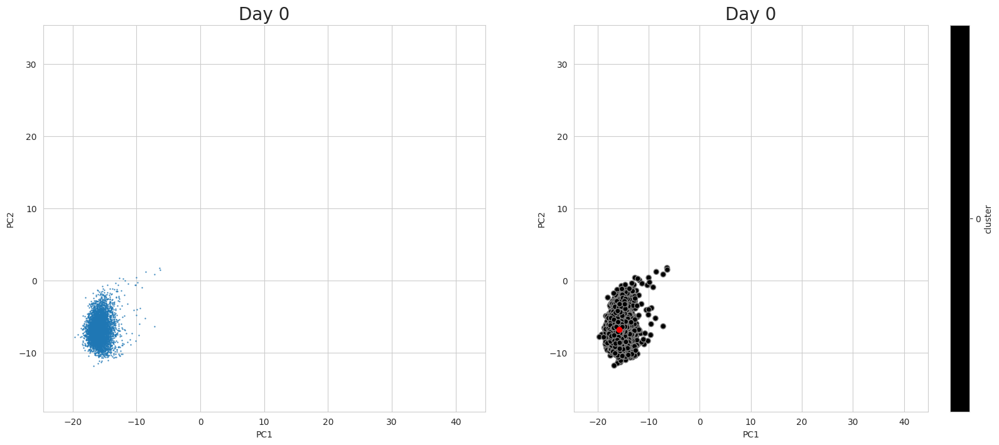

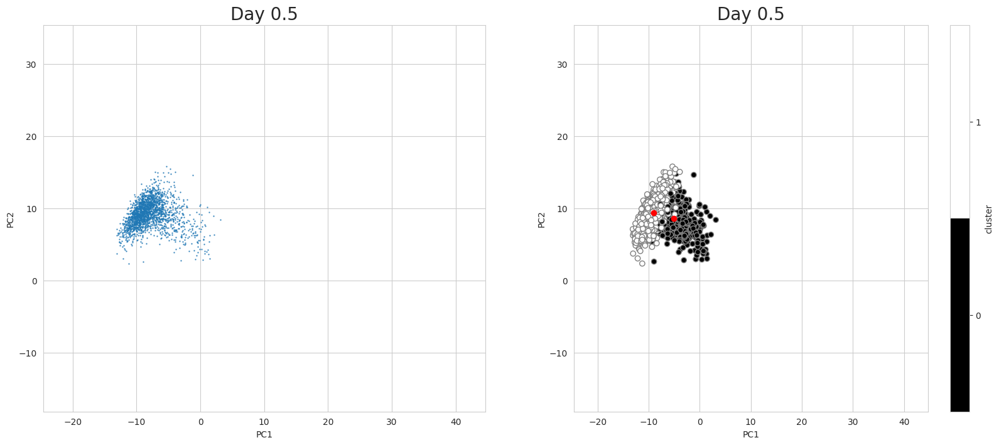

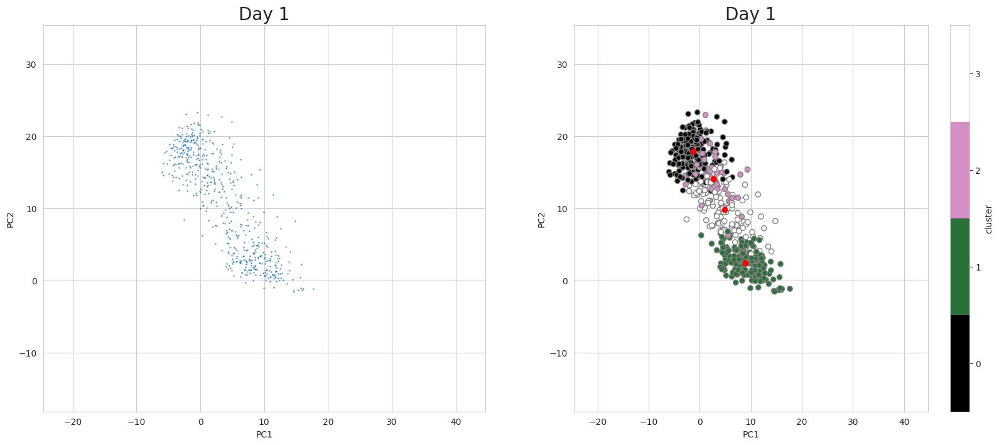

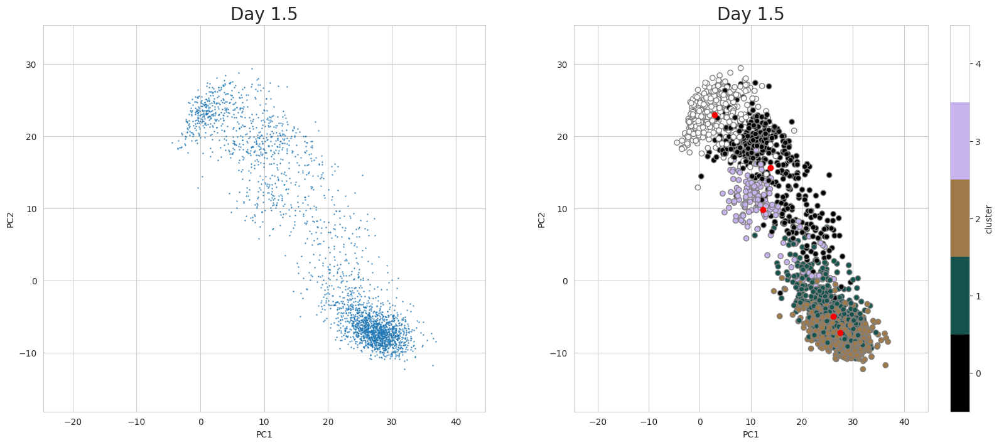

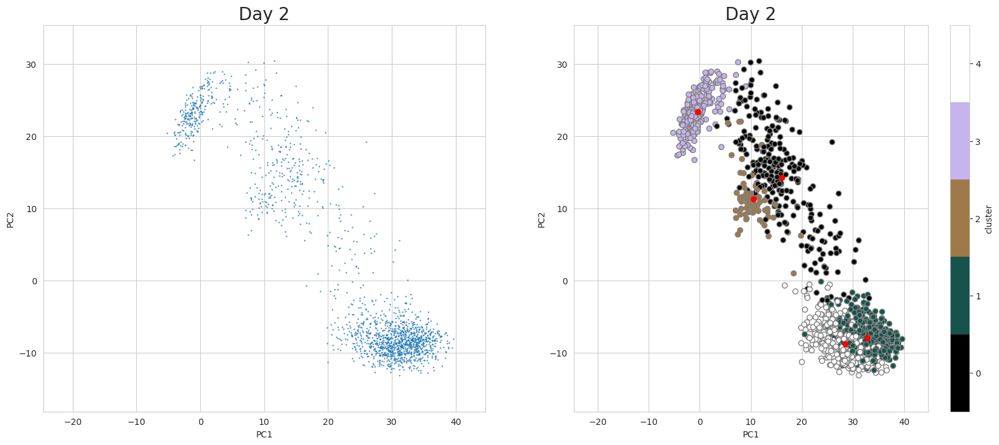

CPU times: user 21.1 s, sys: 2.85 s, total: 23.9 s
Wall time: 22.3 s


In [177]:
%%time
PC1_min = min([np.min(df["PC1"].values) for df in X])
PC1_max = max([np.max(df["PC1"].values) for df in X])
PC2_min = min([np.min(df["PC2"].values) for df in X])
PC2_max = max([np.max(df["PC2"].values) for df in X])
plot_GMM_predictions(
    X,
    gmm_list=gmm_list,
    gmm_labels=gmm_labels,
    x_range=(PC1_min - 5, PC1_max + 5),
    y_range=(PC2_min - 5, PC2_max + 5),
    figure_labels=["PC1", "PC2"],
    figure_titles_without_gmm=FIGURE_TITLES_BY_DAY,
    figure_titles_with_gmm=FIGURE_TITLES_BY_DAY,
    plot_gmm_means=True,
    save=True,
    save_file_paths=[
        os.path.join(FIGURE_PATH_PCA, f"{FIGURE_TITLES_BY_DAY[i]}.png")
        for i in range(len(X))
    ],
)

In [124]:
for i in range(len(gmm_list)):
    with open(
        os.path.join(GMM_MODEL_PATH, f"{DATASET_NAMES_BY_DAY[i]}.pickle"), "wb"
    ) as f:
        pickle.dump(gmm_list[i], f)

In [164]:
for i in range(len(gmm_labels)):
    pd.DataFrame(gmm_labels[i], index=X[i].index, columns=["label"]).to_csv(
        os.path.join(GMM_LABEL_PATH, f"{DATASET_NAMES_BY_DAY[i]}.csv")
    )

## UMAP

### UMAPを適用したデータセットを保存

In [30]:
all_files_after_PCA = sorted(glob.glob("{}*.csv".format(DATASET_PATH_AFTER_PCA)))
print_all_files(all_files_after_PCA)

/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D0.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D05.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D1.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D15.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D2.csv


In [31]:
X = [
    pd.read_csv(all_files_after_PCA[i], index_col=0)
    for i in range(len(all_files_after_PCA))
]

In [32]:
umap_model = umap.UMAP(
    n_components=UMAP_N_COMPONENTS,
    n_neighbors=UMAP_N_NEIGHBORS,
    random_state=RANDOM_STATE,
    min_dist=0.8,
)

In [33]:
%%time
umap_coords = umap_model.fit_transform(pd.concat(X, axis=0, join="inner").values)

CPU times: user 10min 14s, sys: 54.8 s, total: 11min 8s
Wall time: 2min 42s


In [34]:
os.makedirs(UMAP_MODEL_PATH, exist_ok=True)
with open(os.path.join(UMAP_MODEL_PATH, "umap.pickle"), "wb") as f:
    pickle.dump(umap_model, f)

In [129]:
%%time
X_UMAP = apply_UMAP_to_not_concated_data(
    X, UMAP_N_COMPONENTS, UMAP_N_NEIGHBORS, RANDOM_STATE
)

CPU times: user 15min 38s, sys: 1min 33s, total: 17min 12s
Wall time: 3min 33s


Text(0, 0.5, 'UMAP2')

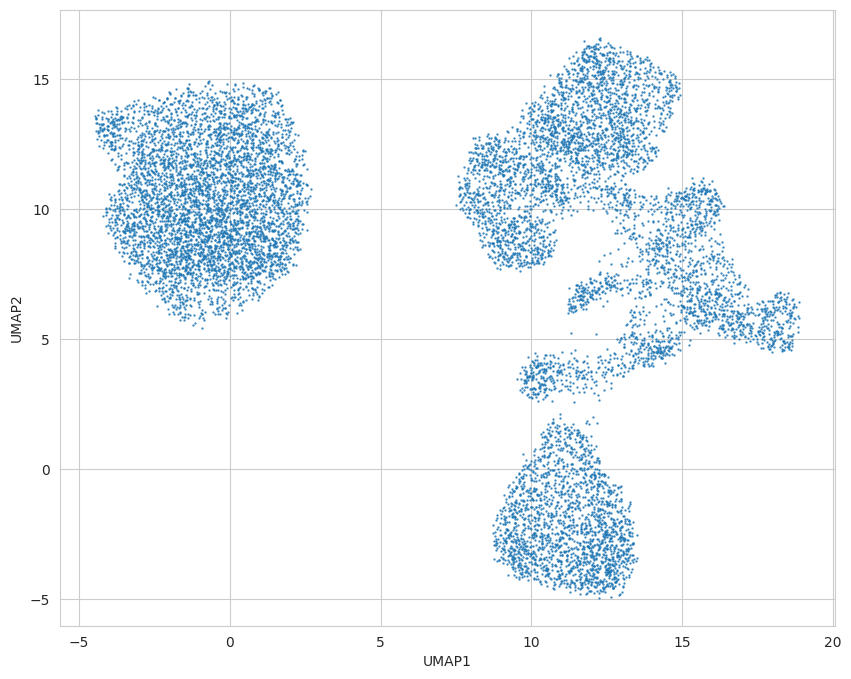

In [130]:
plt.figure(figsize=(10, 8))
plt.scatter(
    pd.concat(X_UMAP, join="inner").values[:, 0],
    pd.concat(X_UMAP, join="inner").values[:, 1],
    s=0.5,
    alpha=0.8,
)
plt.xlabel("UMAP1")
plt.ylabel("UMAP2")

In [140]:
os.makedirs(DATASET_PATH_AFTER_UMAP, exist_ok=True)
for i in range(len(X_UMAP)):
    X_UMAP[i].to_csv(
        os.path.join(DATASET_PATH_AFTER_UMAP, f"{DATASET_NAMES_BY_DAY[i]}.csv")
    )

### UMAP後にGMMを適用した場合の可視化

In [180]:
all_files_after_UMAP = sorted(glob.glob("{}*.csv".format(DATASET_PATH_AFTER_UMAP)))
print_all_files(all_files_after_UMAP)

/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logUMAP/D0.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logUMAP/D05.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logUMAP/D1.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logUMAP/D15.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logUMAP/D2.csv


In [181]:
X = [
    pd.read_csv(all_files_after_UMAP[i], index_col=0)
    for i in range(len(all_files_after_UMAP))
]

In [173]:
gmm_list = []
for i in range(len(X)):
    with open(
        os.path.join(GMM_MODEL_PATH, f"{DATASET_NAMES_BY_DAY[i]}.pickle"), "rb"
    ) as f:
        gmm_list.append(pickle.load(f))

In [174]:
gmm_list

[GaussianMixture(max_iter=2000, n_init=10, random_state=2022),
 GaussianMixture(max_iter=2000, n_components=2, n_init=10, random_state=2022),
 GaussianMixture(max_iter=2000, n_components=4, n_init=10, random_state=2022),
 GaussianMixture(max_iter=2000, n_components=5, n_init=10, random_state=2022),
 GaussianMixture(max_iter=2000, n_components=5, n_init=10, random_state=2022)]

In [175]:
gmm_labels = [
    pd.read_csv(
        os.path.join(GMM_LABEL_PATH, f"{DATASET_NAMES_BY_DAY[i]}.csv"), index_col=0
    )["label"].values
    for i in range(len(X))
]

In [176]:
gmm_labels

[array([0, 0, 0, ..., 0, 0, 0]),
 array([1, 0, 1, ..., 1, 1, 1]),
 array([1, 3, 2, 2, 0, 1, 0, 1, 1, 1, 3, 0, 3, 0, 0, 0, 1, 0, 0, 1, 0, 1,
        0, 0, 1, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 0, 3, 3, 2, 1, 3, 1, 0, 0,
        1, 0, 0, 0, 2, 1, 0, 1, 1, 2, 0, 3, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0,
        0, 1, 3, 0, 2, 3, 0, 0, 1, 0, 0, 2, 3, 1, 0, 0, 2, 1, 0, 1, 0, 1,
        3, 0, 2, 0, 1, 2, 3, 3, 1, 0, 3, 1, 3, 1, 1, 1, 0, 3, 1, 1, 3, 3,
        3, 1, 3, 3, 2, 1, 1, 0, 0, 0, 3, 1, 1, 3, 0, 1, 1, 0, 1, 0, 1, 1,
        1, 2, 3, 3, 0, 0, 2, 2, 1, 1, 2, 1, 1, 3, 1, 0, 0, 0, 3, 0, 0, 0,
        0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 2, 0, 1, 0, 0, 1, 0, 0,
        0, 2, 1, 3, 3, 0, 1, 0, 1, 3, 0, 0, 1, 1, 0, 1, 1, 2, 3, 2, 0, 0,
        3, 1, 2, 2, 0, 3, 3, 3, 3, 0, 1, 1, 3, 3, 3, 0, 0, 0, 3, 3, 1, 3,
        1, 1, 3, 1, 0, 1, 3, 1, 3, 0, 0, 0, 0, 0, 0, 1, 0, 3, 0, 1, 2, 0,
        3, 1, 0, 2, 1, 1, 3, 3, 1, 2, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 3, 2,
        1, 0, 1, 3, 3, 1, 2, 0, 1, 2, 1, 2, 1,

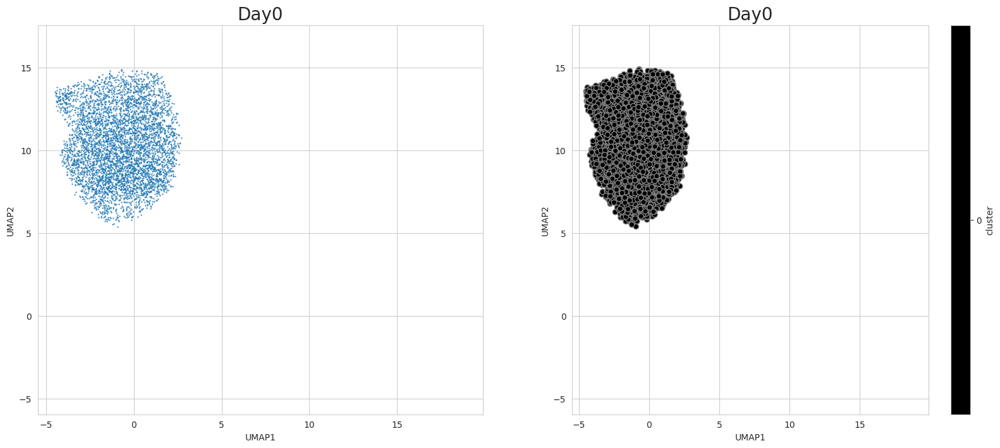

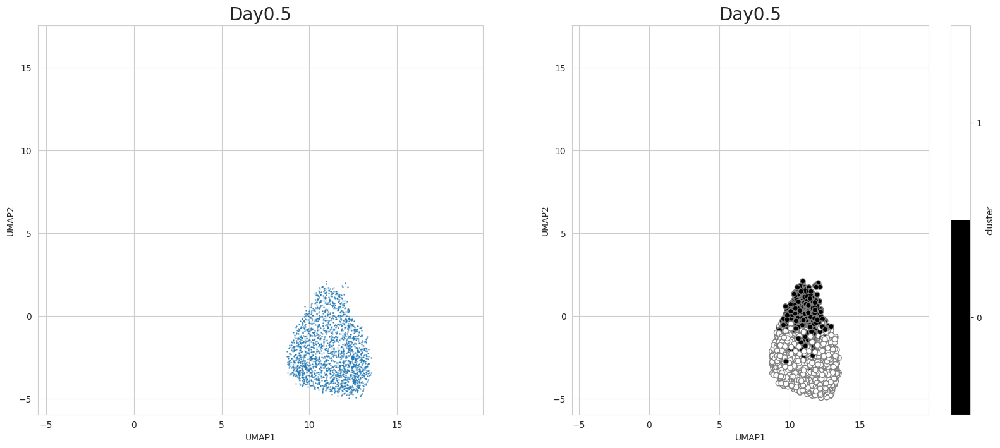

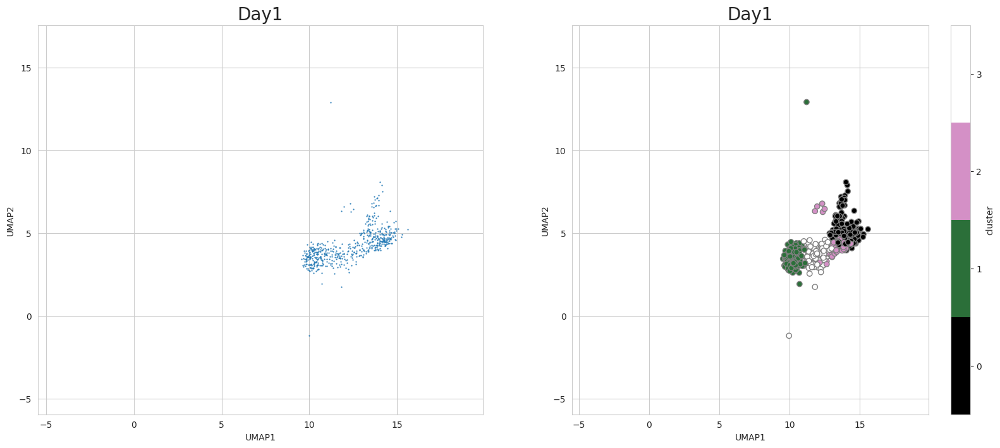

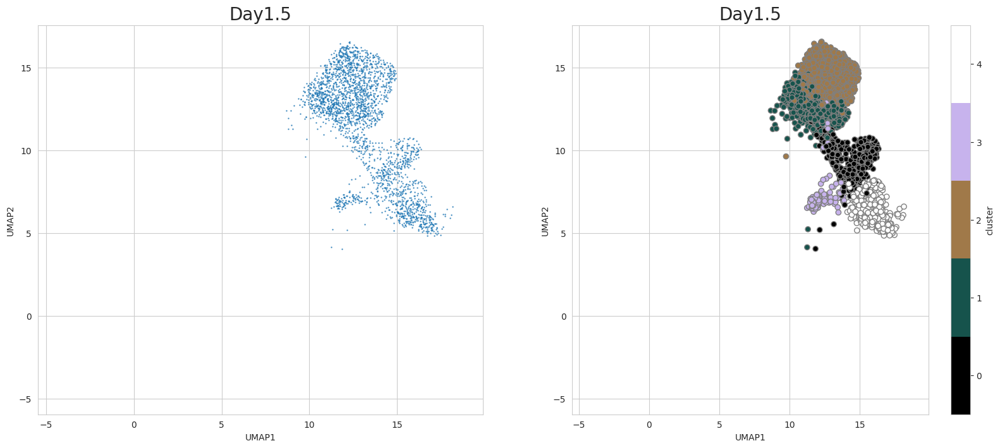

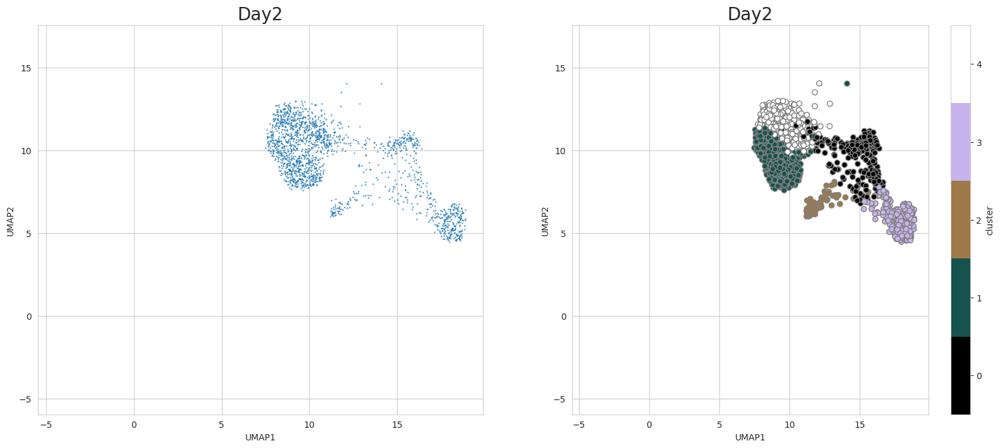

CPU times: user 19.3 s, sys: 2.65 s, total: 22 s
Wall time: 20.2 s


In [185]:
%%time
os.makedirs(FIGURE_PATH_UMAP, exist_ok=True)

UMAP1_min = min([np.min(df["UMAP1"].values) for df in X])
UMAP1_max = max([np.max(df["UMAP1"].values) for df in X])
UMAP2_min = min([np.min(df["UMAP2"].values) for df in X])
UMAP2_max = max([np.max(df["UMAP2"].values) for df in X])

plot_GMM_predictions(
    X,
    gmm_list=gmm_list,
    gmm_labels=gmm_labels,
    x_range=(UMAP1_min - 1, UMAP1_max + 1),
    y_range=(UMAP2_min - 1, UMAP2_max + 1),
    figure_labels=["UMAP1", "UMAP2"],
    figure_titles_without_gmm=FIGURE_NAMES_BY_DAY,
    figure_titles_with_gmm=FIGURE_NAMES_BY_DAY,
    save=True,
    save_file_paths=[
        os.path.join(FIGURE_PATH_UMAP, f"{FIGURE_NAMES_BY_DAY[i]}.png")
        for i in range(len(X))
    ],
)

## 動画（分化の様子？）

In [24]:
all_files_after_PCA = sorted(glob.glob("{}*.csv".format(DATASET_PATH_AFTER_PCA)))
print_all_files(all_files_after_PCA)

/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D0.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D05.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D1.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D15.csv
/home/neko/ASHBi/scEGOT/scEGOT/scEGOT/dataset/output/usedataSMALL_withoutMT/logPCA/D2.csv


In [25]:
X = [
    pd.read_csv(all_files_after_PCA[i], index_col=0)
    for i in range(len(all_files_after_PCA))
]

In [18]:
gmm_list = []
for i in range(len(X)):
    with open(
        os.path.join(GMM_MODEL_PATH, f"{DATASET_NAMES_BY_DAY[i]}.pickle"), "rb"
    ) as f:
        gmm_list.append(pickle.load(f))

In [35]:
with open(os.path.join(UMAP_MODEL_PATH, "umap.pickle"), "rb") as f:
    umap_model = pickle.load(f)

NameError: name 'all_days' is not defined

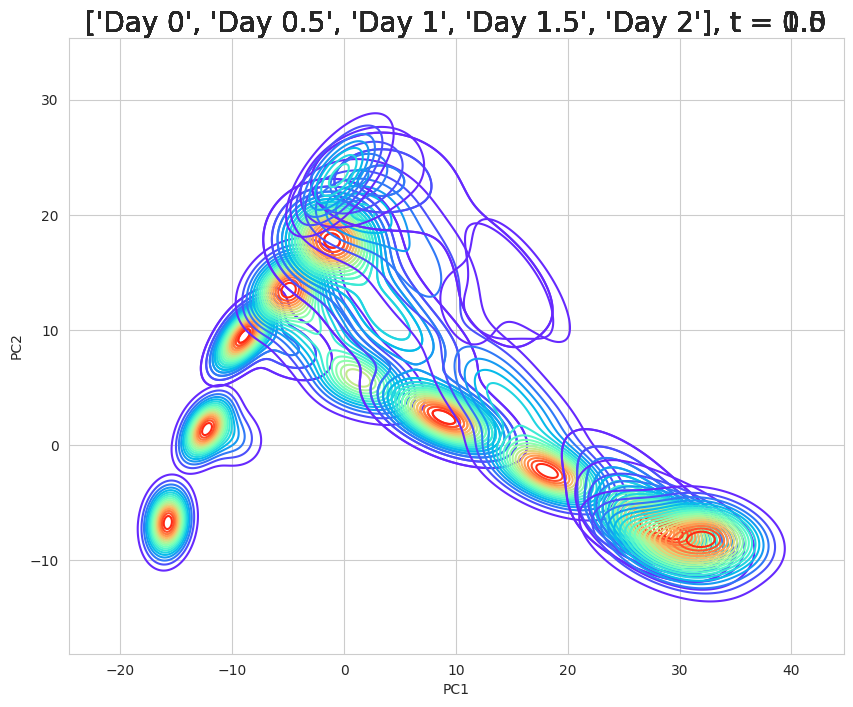

In [36]:
%%time
wstar_all = []
wstar_all_normalized = []
means_all = []
means_UMAP_all = []
label_all = []
means_xpos = []
means_ypos = []
means_xpos_UMAP = []
means_ypos_UMAP = []
node_weights = []
node_day = []
ims = []

x_min = min([np.min(df["PC1"].values) for df in X])
x_max = max([np.max(df["PC1"].values) for df in X])
y_min = min([np.min(df["PC2"].values) for df in X])
y_max = max([np.max(df["PC2"].values) for df in X])

fig, ax = plt.subplots(figsize=(10, 8))
for i in range(len(X) - 1):
    # df1 = pd.read_csv(All_Files[i], index_col=0)
    # df2 = pd.read_csv(All_Files[i + 1], index_col=0)

    gmm1 = gmm_list[i]
    gmm2 = gmm_list[i + 1]
    n_components1 = len(gmm1.weights_)
    n_components2 = len(gmm2.weights_)
    # Compute EGW
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_

    wstar = EGW(
        np.ravel(pi0),
        np.ravel(pi1),
        mu0.reshape(K0, d),
        mu1.reshape(K1, d),
        S0.reshape(K0, d, d),
        S1.reshape(K1, d, d),
    )
    wstar_all.append(wstar)
    wstar_normalized = (wstar.T / gmm1.weights_).T
    wstar_all_normalized.append(wstar_normalized)

    node_weights = np.append(node_weights, gmm1.weights_)
    means_all.append(gmm1.means_)
    for s in range(n_components1):
        node_day = np.append(node_day, float(DAY_LIST_WITH_DECIMAL_POINT[i]))

    t = np.linspace(0, 1, 3)
    for j in range(3):
        im = interpolation_contour(t[j], (x_min - 5, x_max + 5), (y_min - 5, y_max + 5))
        title = ax.text(
            0.5,
            1.0,
            f"{FIGURE_TITLES_BY_DAY}, t = {t[j]:.1f}",
            ha="center",
            va="bottom",
            transform=ax.transAxes,
            fontsize=20,
        )
        plt.xlabel("PC1")
        plt.ylabel("PC2")
        ims.append(im + [title])

node_weights = np.append(node_weights, gmm2.weights_)

for s in range(GMM_CLUSTER_NUMBERS[len(X) - 1]):
    node_day = np.append(node_day, float(DAY_LIST_WITH_DECIMAL_POINT[all_days - 1]))

means_all.append(gmm2.means_)
means_xpos = np.array(list(itertools.chain.from_iterable(means_all))).T[0]
means_ypos = np.array(list(itertools.chain.from_iterable(means_all))).T[1]
means_UMAP_all = umap_model.transform(list(itertools.chain.from_iterable(means_all)))
means_xpos_UMAP = means_UMAP_all.T[0]
means_ypos_UMAP = means_UMAP_all.T[1]

anim = animation.ArtistAnimation(fig, ims, interval=100)
plt.close()
HTML(anim.to_jshtml())

# savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output"
# title = "Test_movie_EGOT1"
# anim.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

## cell state

### グラフ描画の準備

In [67]:
genes_means_all = []
for i in range(all_days):
    genes_means_all_temp = pca.inverse_transform(means_all[i])
    genes_means_all.append(genes_means_all_temp)
genes_length = len(df.columns)
genes_means_all = list(
    itertools.chain.from_iterable(list(itertools.chain.from_iterable(genes_means_all)))
)
genes_value = (
    np.array(genes_means_all).reshape(sum(GMM_CLUSTER_NUMBERS), genes_length).tolist()
)
cluster_all = list_cluster_all(
    All_Files, DAY_LIST_WITH_DECIMAL_POINT, GMM_CLUSTER_NUMBERS
)
cluster_all1d = list(itertools.chain.from_iterable(cluster_all))
df_genes = pd.DataFrame(genes_value, index=cluster_all1d, columns=df.columns)
df_genes = df_genes.where(df_genes > 0, 0)
df_graph = df_makegraph(All_Files, cluster_all, wstar_all_normalized, Thr=0.1)

In [68]:
num = 5
df_genes_nlargest = df_genes.T.apply(get_genes_nlargest, num=num).T
df_genes_nsmallest = df_genes.T.apply(get_genes_nsmallest, num=num).T
df_genes_nlargest.columns += 1
df_genes_nsmallest.columns += 1
df_upgenes = df_up_regulated_genes(df_genes, df_graph, num=num)
df_downgenes = df_down_regulated_genes(df_genes, df_graph, num=num)

In [70]:
# 転写因子
# df_TFgenes_name = pd.read_csv("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/TF_genes/TFgenes_name.csv", index_col=0)
df_TFgenes_name = pd.read_csv(
    f"{DATASET_INPUT_ROOT_PATH}/TF_genes/TFgenes_name.csv", index_col=0
)
df_TFgenes = df_genes.loc[:, df_genes.columns.isin(df_TFgenes_name.columns)]
df_TFgenes_nlargest = df_TFgenes.T.apply(get_genes_nlargest, num=num).T
df_TFgenes_nsmallest = df_TFgenes.T.apply(get_genes_nsmallest, num=num).T
df_TFgenes_nlargest.columns += 1
df_TFgenes_nsmallest.columns += 1
df_TFupgenes = df_up_regulated_genes(df_TFgenes, df_graph, num=num)
df_TFdowngenes = df_down_regulated_genes(df_TFgenes, df_graph, num=num)

### PCA版

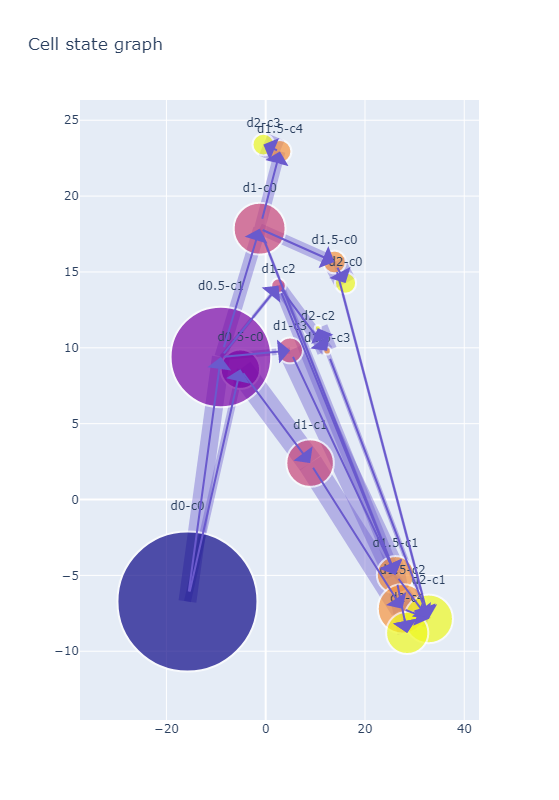

In [71]:
# cell state graph on PCA
G = nx.from_pandas_edgelist(
    df_graph,
    source="source",
    target="target",
    edge_attr=["edge_weights"],
    create_using=nx.DiGraph,
)
pos = {}
df_nodeweights_and_pos = df_makenodeweights_and_pos(
    node_weights, cluster_all1d, means_xpos, means_ypos, node_day
)
for nodename, xpos, ypos, day in zip(
    df_nodeweights_and_pos.index,
    df_nodeweights_and_pos["xpos"],
    df_nodeweights_and_pos["ypos"],
    df_nodeweights_and_pos["node_days"],
):
    G.add_node(nodename, weight=df_nodeweights_and_pos["node_weights"][nodename])
    G.add_node(nodename, day=df_nodeweights_and_pos["node_days"][nodename])
    pos[nodename] = (xpos, ypos)

cell_state_graph(
    G, pos, df_TFgenes_nlargest, df_TFgenes_nsmallest, df_TFupgenes, df_TFdowngenes
)

### UMAP版

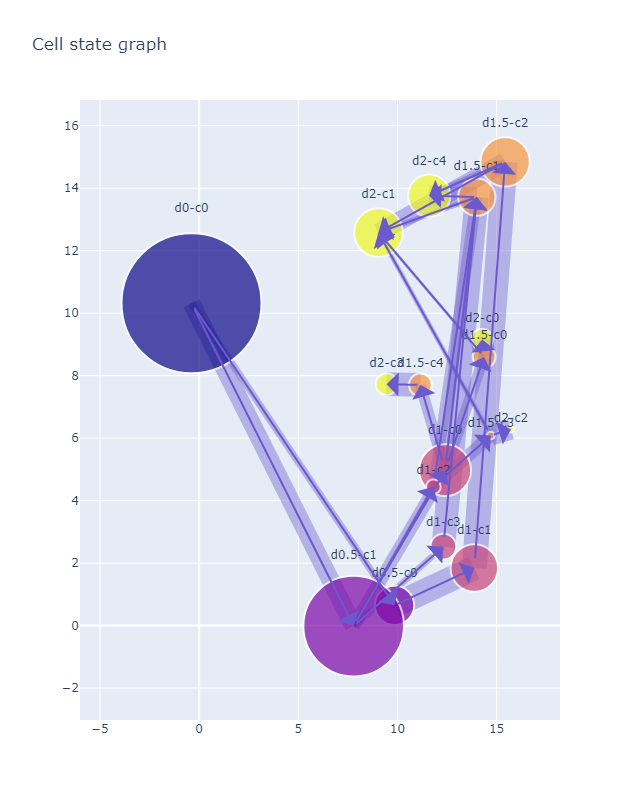

In [72]:
# cell state graph on UMAP
df_UMAPgraph = df_makegraph(All_Files, cluster_all, wstar_all_normalized, Thr=0.1)
G_UMAP = nx.from_pandas_edgelist(
    df_UMAPgraph,
    source="source",
    target="target",
    edge_attr=["edge_weights"],
    create_using=nx.DiGraph,
)
pos_UMAP = {}
df_nodeweights_and_pos_UMAP = df_makenodeweights_and_pos(
    node_weights, cluster_all1d, means_xpos_UMAP, means_ypos_UMAP, node_day
)
for nodename, xpos, ypos, day in zip(
    df_nodeweights_and_pos_UMAP.index,
    df_nodeweights_and_pos_UMAP["xpos"],
    df_nodeweights_and_pos_UMAP["ypos"],
    df_nodeweights_and_pos_UMAP["node_days"],
):
    G_UMAP.add_node(
        nodename, weight=df_nodeweights_and_pos_UMAP["node_weights"][nodename]
    )
    G_UMAP.add_node(nodename, day=df_nodeweights_and_pos_UMAP["node_days"][nodename])
    pos_UMAP[nodename] = (xpos, ypos)

cell_state_graph(
    G_UMAP,
    pos_UMAP,
    df_TFgenes_nlargest,
    df_TFgenes_nsmallest,
    df_TFupgenes,
    df_TFdowngenes,
)

### fold-change

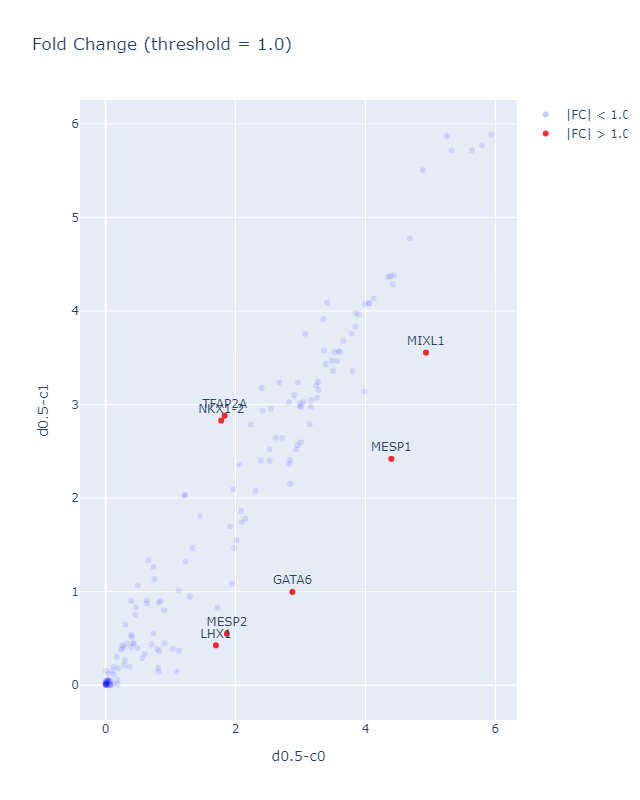

In [73]:
# Fold Change
plot_fold_change(df_TFgenes, "d0.5-c0", "d0.5-c1", threshold=1.0)

## pathway

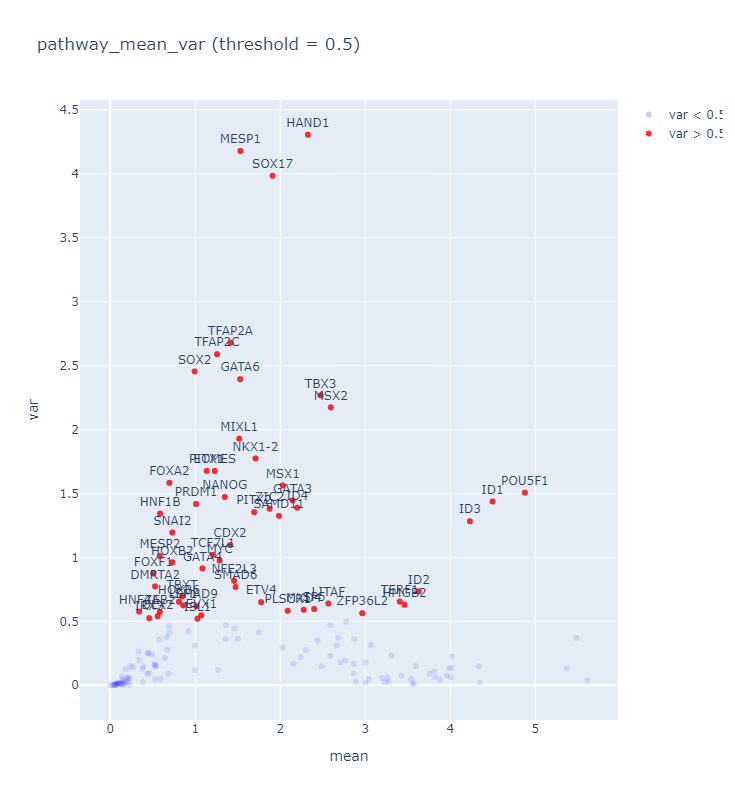

In [74]:
# クラスタを指定することでその経路における遺伝子発現パターンを見ることができる
pathway_name = ["d0-c0", "d0.5-c1", "d1-c1", "d1.5-c4", "d2-c2"]
df_pathway_genes = df_TFgenes.T[pathway_name].T
plot_pathway_mean_var(df_pathway_genes, threshold=0.5)

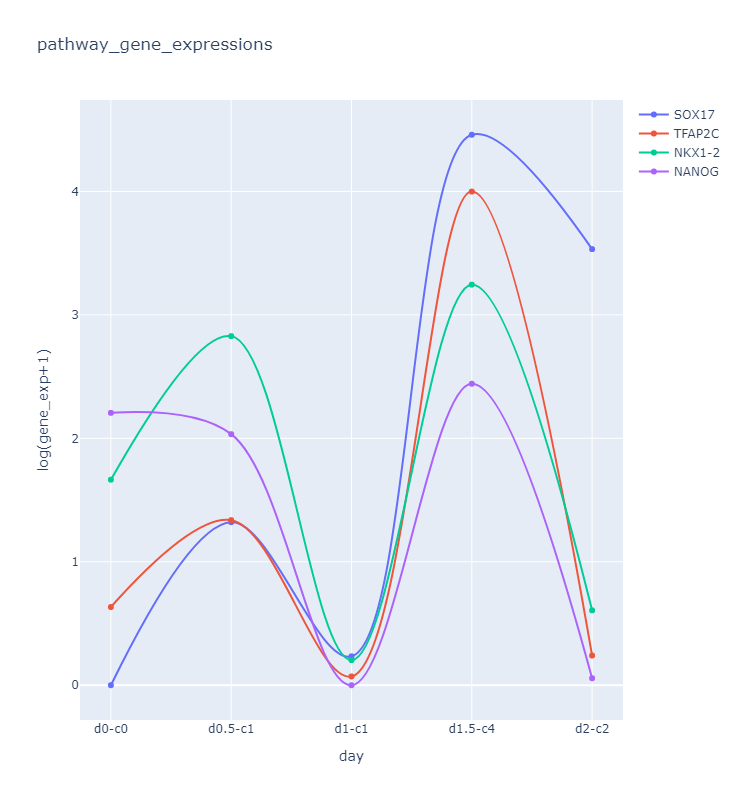

In [75]:
# selected_genes = ['HAND1','FOXF1','MESP1','EOMES']
selected_genes = ["NANOG", "SOX17", "TFAP2C", "NKX1-2"]
plot_pathway_gene_expressions(df_pathway_genes, selected_genes)

## 単一遺伝子のpathway

### PCA版

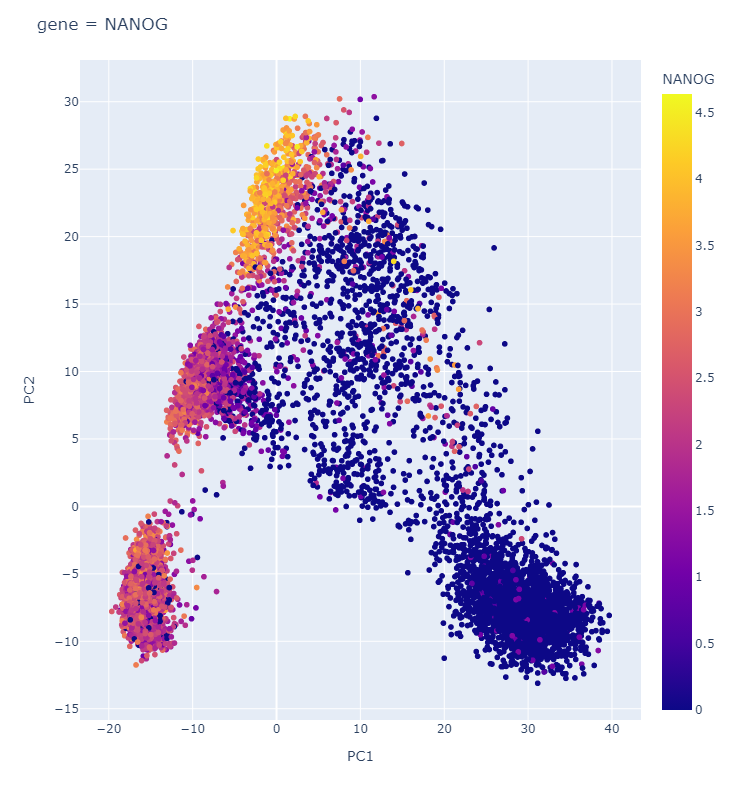

In [76]:
gene_name = "NANOG"
df_for_gene_plot = df_log.copy()
df_for_gene_plot["PC1"] = df_log_PCA["PC1"]
df_for_gene_plot["PC2"] = df_log_PCA["PC2"]
df_for_gene_plot["PC3"] = df_log_PCA["PC3"]
fig = px.scatter(
    df_for_gene_plot,
    x="PC1",
    y="PC2",
    color=gene_name,
    hover_name=df_for_gene_plot.index,
    width=1000,
    height=800,
)
fig.update_layout(title=f"gene = {gene_name}")
fig.show()

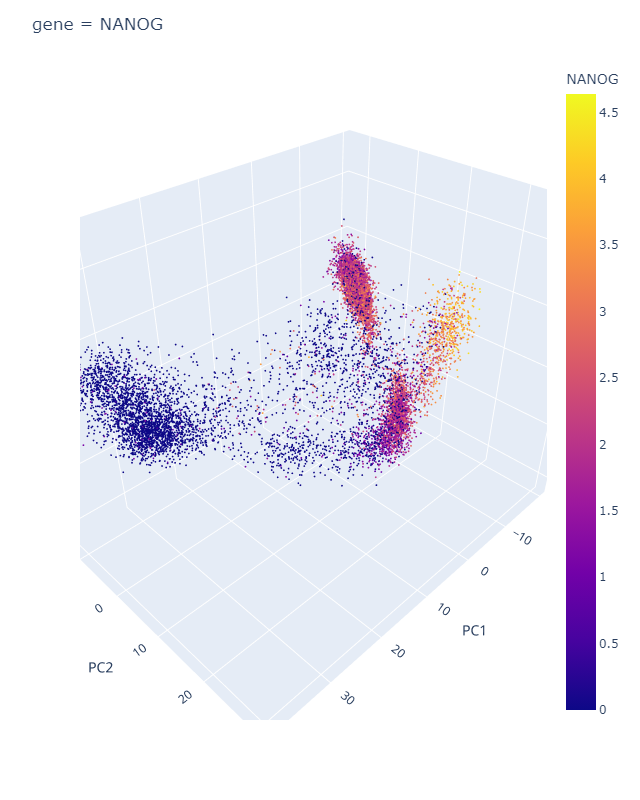

In [77]:
# 3d plot
fig = px.scatter_3d(
    df_for_gene_plot,
    x="PC1",
    y="PC2",
    z="PC3",
    color=gene_name,
    hover_name=df_for_gene_plot.index,
    width=1000,
    height=800,
)
fig.update_traces(marker_size=1)
fig.update_layout(title=f"gene = {gene_name}")
fig.show()

### UMAP版

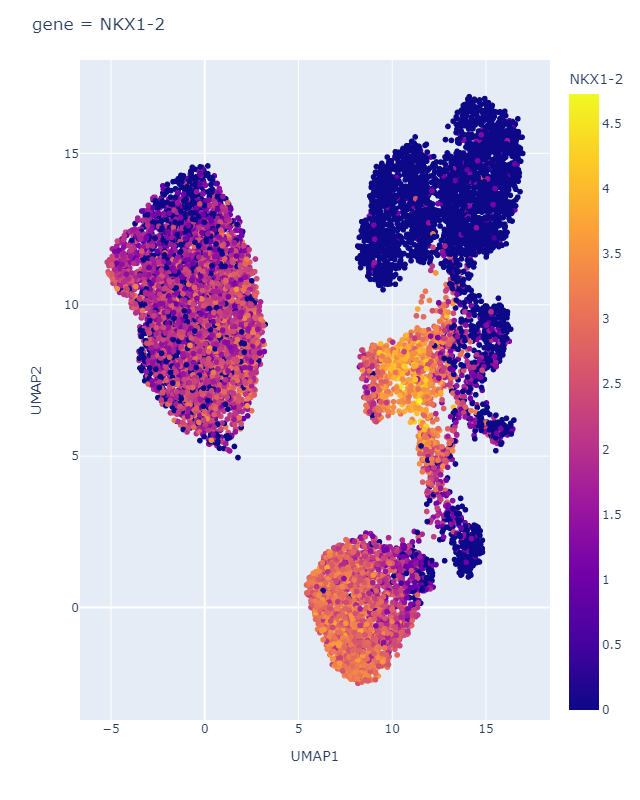

In [78]:
# umap plot
gene_name = "NKX1-2"
df_for_gene_plot_UMAP = df_log.copy()
df_for_gene_plot_UMAP["UMAP1"] = df_log_UMAP["UMAP1"]
df_for_gene_plot_UMAP["UMAP2"] = df_log_UMAP["UMAP2"]
fig = px.scatter(
    df_for_gene_plot_UMAP,
    x="UMAP1",
    y="UMAP2",
    color=gene_name,
    hover_name=df_for_gene_plot_UMAP.index,
    width=1000,
    height=800,
)
fig.update_layout(title=f"gene = {gene_name}")
fig.show()

## interpolation

### 精度チェック

In [88]:
%%time
df1 = pd.read_csv(All_Files[1], index_col=0)
df2 = pd.read_csv(All_Files[3], index_col=0)
n_components1 = GMM_CLUSTER_NUMBERS[1]
n_components2 = GMM_CLUSTER_NUMBERS[3]
n_samples = 2000
gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[1]]
gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[3]]
df_interpolation = df_make_interpolation_data(gmm1, gmm2, df1, df2, n_samples, 0.5)

CPU times: user 525 ms, sys: 438 ms, total: 963 ms
Wall time: 375 ms


Text(0.5, 1.0, 'true and interpolation distributions')

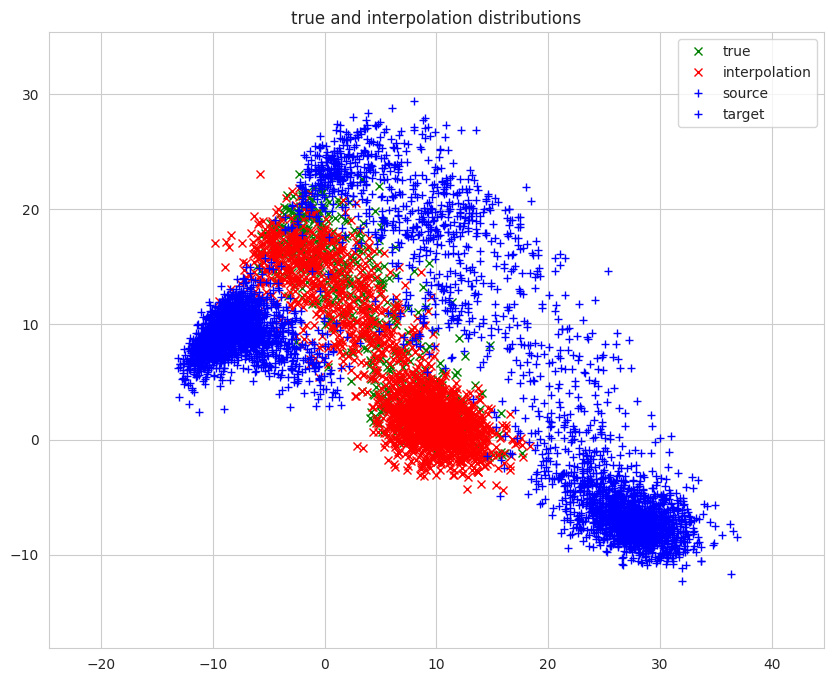

In [89]:
df_true = pd.read_csv(All_Files[2], index_col=0)

fig = plt.figure(figsize=(10, 8))
plt.plot(df_true["PC1"].values, df_true["PC2"].values, "xg", label="true")
plt.plot(
    df_interpolation["PC1"].values,
    df_interpolation["PC2"].values,
    "xr",
    label="interpolation",
)
plt.plot(df1["PC1"].values, df1["PC2"].values, "+b", label="source")
plt.plot(df2["PC1"].values, df2["PC2"].values, "+b", label="target")
plt.xlim(np.min(df_log_PCA["PC1"].values) - 5, np.max(df_log_PCA["PC1"].values) + 5)
plt.ylim(np.min(df_log_PCA["PC2"].values) - 5, np.max(df_log_PCA["PC2"].values) + 5)
plt.legend(loc=0)
plt.title("true and interpolation distributions")
# plt.savefig('compare_true_interpolate_pointdata t=0.5, n=2000.pdf')

### 動画（PCA版）

In [91]:
%%time
target_gene = "NKX1-2"
n_samples = 5000
ims = []

fig, ax = plt.subplots(figsize=(10, 8))

for i in range(all_days - 1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i + 1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i + 1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i + 1]]
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    t = np.linspace(0, 1, 11)
    for j in range(11):
        X_interpolation = interpolation_data(n_samples, t[j])
        X_genes_interpolation = pca.inverse_transform(X_interpolation)
        df_genes_interpolation = pd.DataFrame(X_genes_interpolation, columns=df.columns)
        im = plt.scatter(
            X_interpolation[:, 0],
            X_interpolation[:, 1],
            c=df_genes_interpolation[target_gene].values,
            s=0.5,
            alpha=0.8,
            cmap="rainbow",
        )
        plt.xlabel("PC1")
        plt.ylabel("PC2")
        plt.xlim(
            np.min(df_log_PCA["PC1"].values) - 5, np.max(df_log_PCA["PC1"].values) + 5
        )
        plt.ylim(
            np.min(df_log_PCA["PC2"].values) - 5, np.max(df_log_PCA["PC2"].values) + 5
        )
        plt.clim(
            np.min(df_for_gene_plot[target_gene].values),
            np.max(df_for_gene_plot[target_gene].values),
        )
        if i == 0 and j == 0:
            plt.colorbar()
        title = ax.text(
            0.5,
            1.0,
            f"Day {DAY_LIST_WITH_DECIMAL_POINT[i]}, t = {t[j]:.1f}, gene = {target_gene}",
            ha="center",
            va="bottom",
            transform=ax.transAxes,
            fontsize=20,
        )
        ims.append([im] + [title])

anim_gene = animation.ArtistAnimation(fig, ims, interval=100)
plt.close()
HTML(anim_gene.to_jshtml())

# savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/genes_movie"
# title = f"gene = {target_gene}"
# anim_gene.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

CPU times: user 40.2 s, sys: 1min 3s, total: 1min 44s
Wall time: 19.1 s


### 動画（UMAP版）

KeyboardInterrupt: 

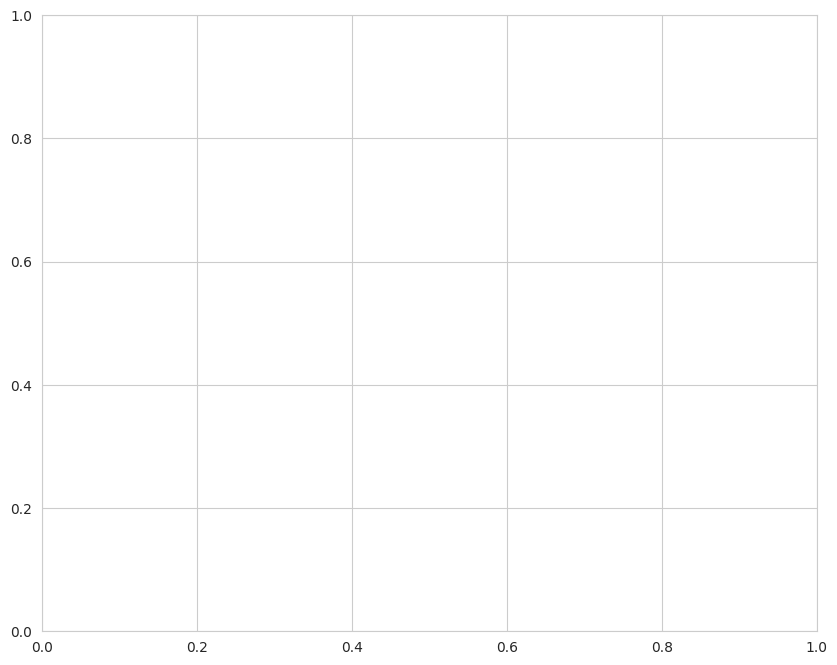

In [94]:
%%time
# umap interpolation movie
# umapでgene expression movieを作るのは計算コストがかなり重いことに注意 1~2時間かかる
target_gene = "NKX1-2"
n_samples = 3000
ims = []

fig, ax = plt.subplots(figsize=(10, 8))

for i in range(all_days - 1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i + 1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i + 1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i + 1]]
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    # t = np.linspace(0, 1, 11)
    # for j in range(11):
    t = np.linspace(0, 1, 2)
    for j in range(2):
        X_interpolation = interpolation_data(n_samples, t[j])
        X_genes_interpolation = pca.inverse_transform(X_interpolation)
        df_genes_interpolation = pd.DataFrame(X_genes_interpolation, columns=df.columns)
        X_interpolation_UMAP = umap_model.transform(X_interpolation)
        im = plt.scatter(
            X_interpolation_UMAP[:, 0],
            X_interpolation_UMAP[:, 1],
            c=df_genes_interpolation[target_gene].values,
            s=0.5,
            alpha=0.8,
            cmap="rainbow",
        )
        plt.xlabel("UMAP1")
        plt.ylabel("UMAP2")
        plt.xlim(
            np.min(df_log_UMAP["UMAP1"].values) - 1,
            np.max(df_log_UMAP["UMAP1"].values) + 1,
        )
        plt.ylim(
            np.min(df_log_UMAP["UMAP2"].values) - 1,
            np.max(df_log_UMAP["UMAP2"].values) + 1,
        )
        plt.clim(
            np.min(df_for_gene_plot_UMAP[target_gene].values),
            np.max(df_for_gene_plot_UMAP[target_gene].values),
        )
        if i == 0 and j == 0:
            plt.colorbar()
        title = ax.text(
            0.5,
            1.0,
            f"Day {DAY_LIST_WITH_DECIMAL_POINT[i]}, t = {t[j]:.1f}, gene = {target_gene}",
            ha="center",
            va="bottom",
            transform=ax.transAxes,
            fontsize=20,
        )
        ims.append([im] + [title])

anim_gene = animation.ArtistAnimation(fig, ims, interval=150)
plt.close()
HTML(anim_gene.to_jshtml())

# savedir = "/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/genes_movie/UMAP"
# title = f"gene = {target_gene}"
# anim_gene.save('%s/%s.gif'%(savedir,title),writer=PillowWriter(fps=8),dpi=300)

## cell velocity

### PCA版

In [100]:
%%time
# Cell velocity
x_coordinate = []
y_coordinate = []
x_velocity = []
y_velocity = []
speed = []
df_x = pd.DataFrame(columns=df_log.columns)
df_velocity = pd.DataFrame(columns=df_log.columns)

for i in range(all_days - 1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i + 1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i + 1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i + 1]]
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    velo_temp = compute_cell_velocity(gmm1, gmm2, df1)
    U = velo_temp[:, 0]
    V = velo_temp[:, 1]

    x_coordinate = np.append(x_coordinate, df1["PC1"].values)
    y_coordinate = np.append(y_coordinate, df1["PC2"].values)
    x_velocity = np.append(x_velocity, U)
    y_velocity = np.append(y_velocity, V)
    speed = np.append(speed, np.sqrt(U**2 + V**2))

    xx = pca.inverse_transform(df1.values)
    df_xtemp = pd.DataFrame(xx, columns=df_log.columns)
    df_x = pd.concat([df_x, df_xtemp], axis=0, join="inner")
    df_x = df_x.where(df_x > 0, 0)
    df_TFx = df_x.loc[:, df_x.columns.isin(df_TFgenes_name.columns)]
    df_TFx = df_TFx.where(df_TFx > 0, 0)

    velo_x = pca.inverse_transform(velo_temp)
    dfvelo_x = pd.DataFrame(velo_x, columns=df_log.columns)
    df_velocity = pd.concat([df_velocity, dfvelo_x], axis=0, join="inner")
    df_TFvelocity = df_velocity.loc[
        :, df_velocity.columns.isin(df_TFgenes_name.columns)
    ]

CPU times: user 23.5 s, sys: 36.7 s, total: 1min
Wall time: 11.3 s


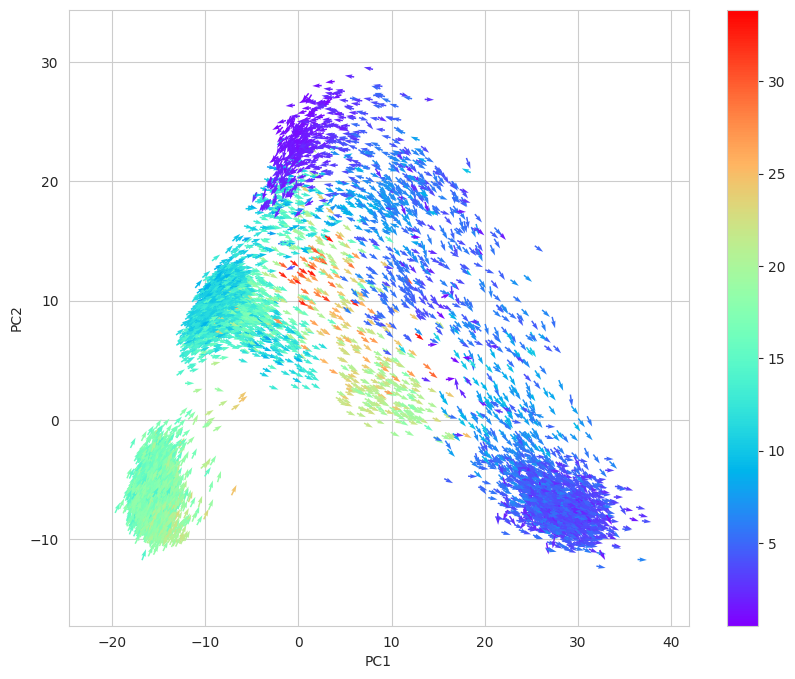

In [101]:
cell_velocity_plot(
    x_coordinate,
    y_coordinate,
    x_velocity,
    y_velocity,
    speed,
    cmap="rainbow",
    mode="PCA",
)

### UMAP版

In [103]:
%%time
# Cell velocity on UMAP
# 22分かかった
x_coordinate_UMAP = []
y_coordinate_UMAP = []
x_velocity_UMAP = []
y_velocity_UMAP = []
speed_UMAP = []

for i in range(all_days - 1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i + 1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i + 1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i + 1]]
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    velo_temp = compute_cell_velocity(gmm1, gmm2, df1)
    velo_temp_UMAP = umap_model.transform(velo_temp)
    U = velo_temp[:, 0]
    V = velo_temp[:, 1]
    U_UMAP = velo_temp_UMAP[:, 0]
    V_UMAP = velo_temp_UMAP[:, 1]

    coordinate_UMAP = umap_model.transform(df1.values)
    x_coordinate_UMAP = np.append(x_coordinate_UMAP, coordinate_UMAP[:, 0])
    y_coordinate_UMAP = np.append(y_coordinate_UMAP, coordinate_UMAP[:, 1])
    x_velocity_UMAP = np.append(x_velocity_UMAP, U_UMAP)
    y_velocity_UMAP = np.append(y_velocity_UMAP, V_UMAP)
    speed_UMAP = np.append(speed_UMAP, np.sqrt(U_UMAP**2 + V_UMAP**2))

CPU times: user 20min 50s, sys: 0 ns, total: 20min 50s
Wall time: 22min 13s


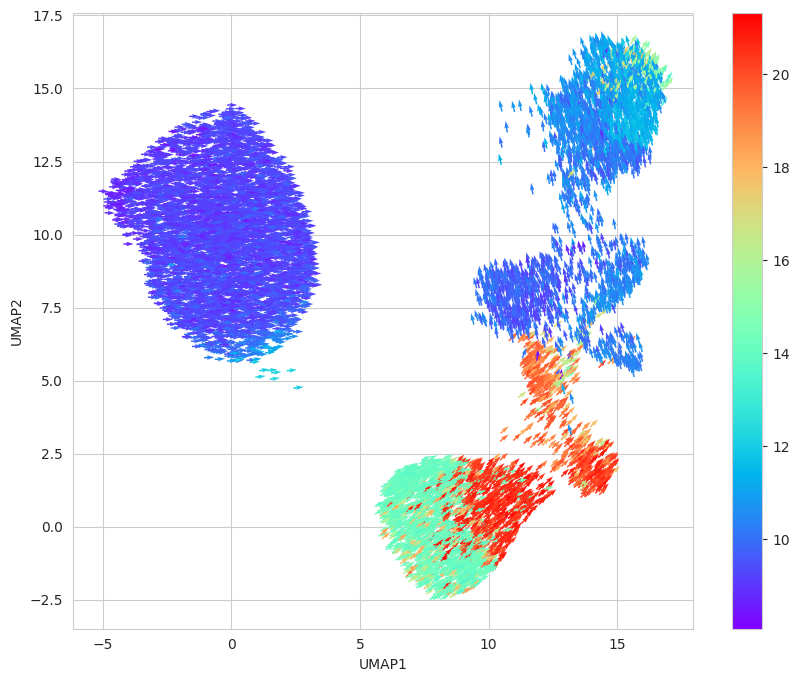

In [104]:
cell_velocity_plot(
    x_coordinate_UMAP,
    y_coordinate_UMAP,
    x_velocity_UMAP,
    y_velocity_UMAP,
    speed_UMAP,
    cmap="rainbow",
    mode="UMAP",
)

### Others

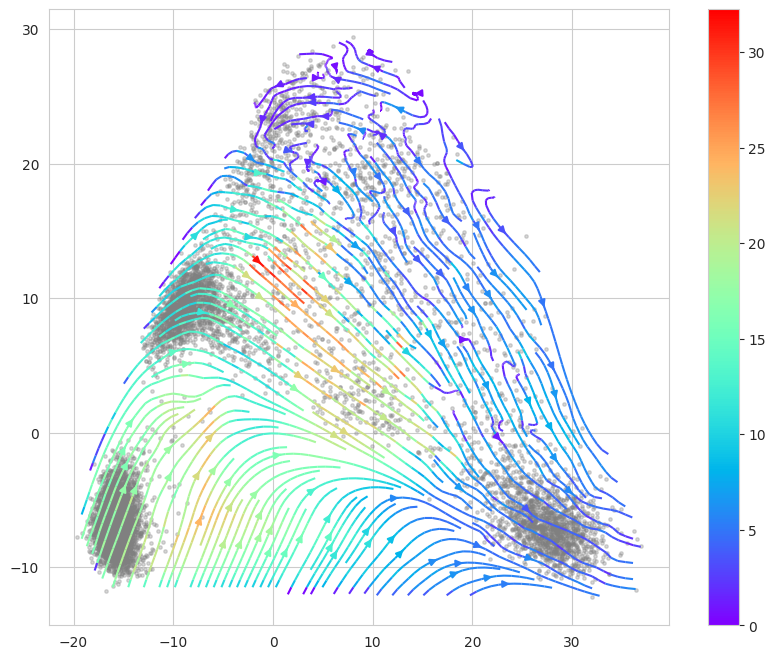

In [105]:
# Interpolation cell velocity
numx = numy = 300
xmin = np.min(df_log_PCA["PC1"].values) - 5
xmax = np.max(df_log_PCA["PC1"].values) + 5
ymin = np.min(df_log_PCA["PC2"].values) - 5
ymax = np.max(df_log_PCA["PC2"].values) + 5

x = np.linspace(xmin, xmax, numx)
y = np.linspace(ymin, ymax, numy)
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T

points = np.transpose(np.vstack((x_coordinate, y_coordinate)))
strm_x_velocity = interpolate.griddata(
    points, x_velocity, (X, Y), method="linear", fill_value=0
)
strm_y_velocity = interpolate.griddata(
    points, y_velocity, (X, Y), method="linear", fill_value=0
)
strm_speed = np.sqrt(strm_x_velocity**2 + strm_y_velocity**2)

plt.figure(figsize=(10, 8))
strm = plt.streamplot(
    X,
    Y,
    strm_x_velocity,
    strm_y_velocity,
    density=3.0,
    color=strm_speed,
    cmap="rainbow",
)
plt.scatter(x_coordinate, y_coordinate, c="gray", s=6, alpha=0.3)
plt.colorbar(strm.lines)
# plt.savefig("/Users/yachimura/Code/Kojima_202011_PGCLC_10X/output/RNAvelocitylike.png",dpi=300)
plt.show()

alpha =  0.01


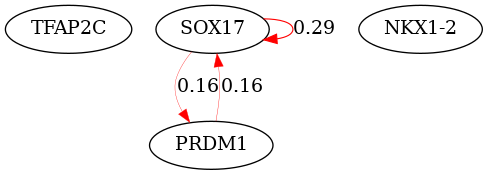

alpha =  1.2742749857031335


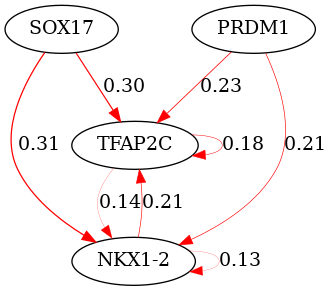

alpha =  1.2742749857031335


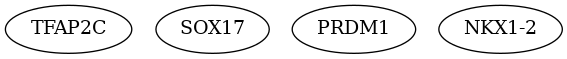

alpha =  3.359818286283781


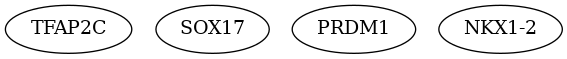

CPU times: user 3min 29s, sys: 10min 28s, total: 13min 57s
Wall time: 1min 29s


In [110]:
%%time

# in silico perturbation
x_velocity_KO = []
y_velocity_KO = []
speed_KO = []

for i in range(all_days - 1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i + 1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i + 1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i + 1]]
    d = PCA_N_COMPONENTS
    K0, K1 = n_components1, n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]

    velo_temp = compute_cell_velocity(gmm1, gmm2, df1)

    xx = pca.inverse_transform(df1.values)
    df_xtemp = pd.DataFrame(xx, columns=df_log.columns)
    df_TFxtemp = df_xtemp.loc[:, df_xtemp.columns.isin(df_TFgenes_name.columns)]

    velo_x = pca.inverse_transform(velo_temp)
    dfvelo_x = pd.DataFrame(velo_x, columns=df_log.columns)
    df_TFvelo_x = dfvelo_x.loc[:, dfvelo_x.columns.isin(df_TFgenes_name.columns)]

    alphas_cv = np.logspace(-2, 2, num=20)
    reg_cv = linear_model.RidgeCV(alphas=alphas_cv, cv=3, fit_intercept=False)
    reg_cv.fit(df_TFxtemp, df_TFvelo_x)
    print("alpha = ", reg_cv.alpha_)
    GRN = linear_model.Ridge(alpha=reg_cv.alpha_, fit_intercept=False)
    GRN.fit(df_TFxtemp, df_TFvelo_x)
    df_GRN = pd.DataFrame(
        GRN.coef_, index=df_TFxtemp.columns, columns=df_TFxtemp.columns
    )
    genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
    GRNgraph = make_GRN(df_GRN[genes].loc[genes], threshold=0.1)
    display(Image(GRNgraph.create(format="png")))

    # insilico perturbation
    # KOgenes = ['TFAP2C','SOX17','PRDM1','NKX1-2']
    # df_A_KO = df_GRN.copy()
    # df_A_KO.loc[KOgenes] = 0
    # vgenes_KO = np.dot(df_A_KO.values,df_xtemp.values.T).T
    # vgenes_KO_PCA = pca.transform(vgenes_KO)
    # U_KO = vgenes_KO_PCA[:,0]
    # V_KO = vgenes_KO_PCA[:,1]
    # x_velocity_KO = np.append(x_velocity_KO,U_KO)
    # y_velocity_KO = np.append(y_velocity_KO,V_KO)
    # speed_KO = np.append(speed_KO,np.sqrt(U_KO**2+V_KO**2))

In [ ]:
#cell_velocity_plot(x_coordinate,y_coordinate,x_velocity_KO,y_velocity_KO,speed_KO,cmap='rainbow',mode='PCA')

In [ ]:
%%time
# Waddington landscapeの再実装 点群でのWaddington landscape

# -Laplacian phi = div f　をグラフ上で解く
# Laplacianは組み合わせ論的Laplacianで，　div fは具体的に計算できる

F_all = []
df_x_PCA2dim = pd.DataFrame(columns=['PC1','PC2'])

for i in range(all_days-1):
    df1 = pd.read_csv(All_Files[i], index_col=0)
    df2 = pd.read_csv(All_Files[i+1], index_col=0)
    n_components1 = GMM_CLUSTER_NUMBERS[i]
    n_components2 = GMM_CLUSTER_NUMBERS[i+1]
    gmm1 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i]]
    gmm2 = gmm_all[DAY_LIST_WITH_DECIMAL_POINT[i+1]]
    d  = PCA_N_COMPONENTS
    K0,K1 = n_components1,n_components2
    pi0 = gmm1.weights_
    mu0 = gmm1.means_
    S0 = gmm1.covariances_
    pi1 = gmm2.weights_
    mu1 = gmm2.means_
    S1 = gmm2.covariances_
    wstar = wstar_all[i]
    
    df1_2dim = df1.loc[:,['PC1','PC2']].copy()
    # Waddington potential
    B:float = 0
    F:float = 0
    for i in range(K0):
        B = B + np.nan_to_num(np.dot(np.linalg.pinv(S0)[i,:,:],(df1.values-mu0[i,:]).T)*pi0[i]*sps.multivariate_normal.pdf(df1.values,mean=mu0[i,:],cov=S0[i,:,:])/densite_theorique2d(mu0,S0,pi0,df1.values))
    for k in range(K0):
        A = np.dot(np.linalg.pinv(S0)[k,:,:],(df1.values-mu0[k,:]).T)
        I1 = -A + B
        #I1 = I1[0:2,:]
        for l in range(K1):
            P = wstar[k,l]*sps.multivariate_normal.pdf(df1.values,mean=mu0[k,:],cov=S0[k,:,:])/densite_theorique2d(mu0,S0,pi0,df1.values).T
            P = np.nan_to_num(P)
            Tmap = GaussianMap(mu0[k,:],mu1[l,:],S0[k,:,:],S1[l,:,:],df1.values).T
            Tmap = Tmap.real
            #Tmap = Tmap[0:2,:]
            I2 = np.nan_to_num(np.trace(np.linalg.pinv(S0[k,:,:])@spl.sqrtm(S0[k,:,:]@S1[l,:,:])))
            I2 = I2.real
            F = F + np.sum(np.dot(I1,Tmap.T))*P + I2*P
    F = F - d
    F_all = np.append(F_all,F)
    df_x_PCA2dim = pd.concat([df_x_PCA2dim, df1_2dim], axis=0, join='inner')
    
knn = kneighbors_graph(X=df_x_PCA2dim.values,n_neighbors=100,mode='distance',metric='euclidean')
# compute kernel
sim = sparse.csr_matrix(knn.shape)
nonzero = knn.nonzero()
sig = 10
sim[nonzero] = np.exp(-np.array(knn[nonzero])**2/sig**2)
sim = (sim+sim.T)/2
deg = sim.sum(axis=1)
n = df_x_PCA2dim.values.shape[0]
dia = np.diag(np.array(deg).reshape(n,))
lap = dia - sim
lap = np.array(lap)
Wpotential = np.dot(np.linalg.pinv(lap),F_all.T)

Wpotential = scipy.stats.zscore(Wpotential)

In [ ]:
#potential 3d plot
df_potential = df_x_PCA2dim.copy()
df_potential['potential'] = Wpotential
fig = px.scatter_3d(df_potential,x='PC1',y='PC2',z='potential',hover_name=df_potential.index,width=1000,height=800)
fig.update_traces(marker_size = 1)
fig.update_layout(title='Waddington potential')
fig.show()

In [ ]:
# potential plot color: gene expression
gene_name = 'NKX1-2'
df_potential_gene_plot = df_log.copy()
df_potential_gene_plot['PC1'] = df_potential['PC1']
df_potential_gene_plot['PC2'] = df_potential['PC2']
df_potential_gene_plot['potential'] = df_potential['potential']
fig = px.scatter_3d(df_potential_gene_plot,x='PC1',y='PC2',z='potential',color=gene_name,hover_name=df_potential_gene_plot.index,width=1000,height=800)
fig.update_traces(marker_size = 1)
fig.update_layout(title=f'Waddington potential, gene = {gene_name}')
fig.show()